# **Haplo-Insufficient Gene Overlaps in Controldb Ins/Dup**

**Author:** Shuk

**Background**

ARUP (Katie Rudd et. al.) has been tracking down partial duplications that have one bkpt in a haploinsufficient (HI) gene. These partial duplications do not disrupt genes, but a lot of labs call these as variants of uncertain significance (VUS).

A .bed file of 354 HI=3 genes was provided. These coordinates are to be aligned against our de novo constitutional hg38 controlsdb database.

In [1]:
# load packages
from itertools import groupby
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import copy
import re 
import os
import pathlib
working_dir = pathlib.Path().absolute()
os.chdir(working_dir)

%matplotlib inline

In [2]:
# Output file for QC
def out_file(df, name):
    df.to_csv(rf"output\output_28Mar2023\{name}.csv", index=False)

def in_file(name):
    df = pd.read_csv(rf"output\output_28Mar2023\{name}.csv", dtype=object, index_col=False)
    return df

## Load and inspect .bed file

-   any of these entries in a 'messy' region?
-   distribution across all chromosomes?

In [3]:
# Standardized headers for both bed files
# headers: chrom	chromStart	chromEnd	Gene	Index	strand	chromStart2	chromEnd	RGB

# Load HI gene list
bed_headers = ["chr","RefStartPos","RefEndPos","Gene"]
hi_df = pd.read_csv(r"input\354_HI3_genes.bed", dtype=object, index_col=False, sep="\t", names=bed_headers)
hi_df = hi_df.astype({'RefStartPos':'float64', 'RefEndPos':'float64', 'chr':'int'})

# Load hg38.knownCanonical.bed
bed_df = pd.read_csv(r"input\hg38.knownCanonical.mapped_KH.bed", dtype=object, index_col=False, sep="\t")
bed_df = bed_df.astype({'RefStartPos':'float64', 'RefEndPos':'float64', 'chr':'int'})

# Load hg38_gaps.bed
bed_headers = ["chr","RefStartPos","RefEndPos","Gene","Index","Strand","RefStartPos2","RefEndPos2","RGB"]
gaps_df = pd.read_csv(r"input\hg38_gaps.bed", dtype=object,  index_col=False, sep="\t", names=bed_headers)
gaps_df = gaps_df.astype({'RefStartPos':'float64', 'RefEndPos':'float64', 'chr':'int'})

# Load hg38_primary transcripts.bed (exons)
bed_headers = ["chr","Source","Feature","RefStartPos","RefEndPos","Score","Strand","Frame","Attribute"]
pt_df = pd.read_csv(r"input\hg38-primary_transcripts.bed", dtype=object,  index_col=False, sep="\t", names=bed_headers)
pt_df = pt_df.astype({'RefStartPos':'float64', 'RefEndPos':'float64', 'chr':'int'})

# Load exons file intersection between pt_df and hi_df
exons_df = pd.read_csv(r"output\output_28Mar2023\hg38_HI_exons.csv", dtype=object,  index_col=False)
exons_df = exons_df.astype({'RefStartPos':'float64', 'RefEndPos':'float64', 'chr':'int'})

# Load gene legend file for matching
# legend_df = pd.read_csv(r"input\knownGene_to_geneSymbol.txt", dtype=object,  index_col=False, sep="\t")

In [4]:
exons_df.head()

,chr,Source,Feature,RefStartPos,RefEndPos,Score,Strand,Frame,Attribute,Gene
0,15,refGene,exon,67200675.0,67202898.0,.,-,.,"gene_id ""AAGAB""; transcript_id ""NM_001271885"";...",AAGAB_exon_1
1,15,refGene,exon,67255137.0,67255198.0,.,-,.,"gene_id ""AAGAB""; transcript_id ""NM_001271885"";...",AAGAB_exon_10
2,15,refGene,exon,67203548.0,67203597.0,.,-,.,"gene_id ""AAGAB""; transcript_id ""NM_001271885"";...",AAGAB_exon_2
3,15,refGene,exon,67204044.0,67204148.0,.,-,.,"gene_id ""AAGAB""; transcript_id ""NM_001271885"";...",AAGAB_exon_3
4,15,refGene,exon,67208562.0,67208658.0,.,-,.,"gene_id ""AAGAB""; transcript_id ""NM_001271885"";...",AAGAB_exon_4


Text(0.5, 1.0, 'Distribution of Haploinsufficient Genes\n.bed File by Chromosome (n=354)')

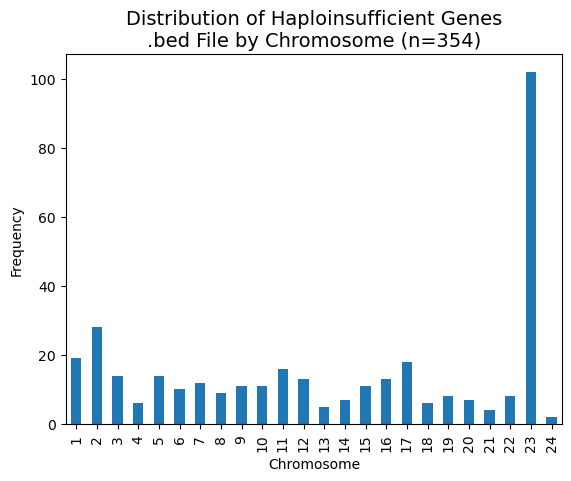

In [5]:
hi_df['chr'].value_counts().sort_index().plot(kind='bar', xlabel='Chromosome', ylabel='Frequency')
plt.title(f"Distribution of Haploinsufficient Genes\n.bed File by Chromosome (n={len(hi_df)})", fontsize=14)

Most sequences in chrX, chr2, and chr17. 

## Find HI gene and exon coordinates from hg38_primary transcripts .gtf

### Find HI gene coordinates in hg38 primary transcripts .gtf

knownCanonical does NOT have SHOX amd ARSL, nor exon information

In [6]:
hi_genes = np.array(hi_df['Gene'].unique())

list(set(hi_df['Gene']) - set(bed_df.loc[bed_df['Gene'].isin(hi_genes)]['Gene']))

['ARSL', 'SHOX']

hg38 primary transcripts has information on exon and genes, also used in NXClinical

In [7]:
# df = pd.DataFrame()
def filter_HI_genes(df):

    def match_bed_row(attribute):
        print(attribute)
        gene_id = attribute.split(";")[0].split("\"")[1]

        if gene_id in np.array(hi_df['Gene']):
            return gene_id
        else:
            return "-"

    df = df.sort_values(['chr', 'RefStartPos', 'RefEndPos'])
    df['Gene'] = df.apply(lambda x: match_bed_row(x['Attribute']), axis=1)
    return df

In [8]:
hi_gene_df = pt_df.loc[pt_df['Feature'] == 'transcript']
hi_gene_df = filter_HI_genes(hi_gene_df.copy())

gene_id "DDX11L1"; transcript_id "NR_046018";  gene_name "DDX11L1";
gene_id "WASH7P"; transcript_id "NR_024540";  gene_name "WASH7P";
gene_id "MIR6859-1"; transcript_id "NR_106918";  gene_name "MIR6859-1";
gene_id "MIR6859-2"; transcript_id "NR_107062";  gene_name "MIR6859-2";
gene_id "MIR6859-3"; transcript_id "NR_107063";  gene_name "MIR6859-3";
gene_id "MIR6859-4"; transcript_id "NR_128720";  gene_name "MIR6859-4";
gene_id "MIR1302-2"; transcript_id "NR_036051";  gene_name "MIR1302-2";
gene_id "MIR1302-10"; transcript_id "NR_036267";  gene_name "MIR1302-10";
gene_id "MIR1302-11"; transcript_id "NR_036268";  gene_name "MIR1302-11";
gene_id "MIR1302-9"; transcript_id "NR_036266";  gene_name "MIR1302-9";
gene_id "FAM138A"; transcript_id "NR_026818";  gene_name "FAM138A";
gene_id "FAM138F"; transcript_id "NR_026820";  gene_name "FAM138F";
gene_id "FAM138C"; transcript_id "NR_026822";  gene_name "FAM138C";
gene_id "OR4F5"; transcript_id "NM_001005484";  gene_name "OR4F5";
gene_id "LOC729

Found all 354 genes and no difference in gene names with the original hi_df.

In [9]:
len(set(hi_gene_df.loc[hi_gene_df['Gene'] != '-']['Gene']))

354

In [10]:
list(set(hi_df['Gene']) - set(hi_gene_df.loc[hi_gene_df['Gene'] != '-']['Gene']))

[]

output as bed file

In [11]:
display(hi_gene_df.head())
hi_gene_df = hi_gene_df.loc[hi_gene_df['Gene'] != "-"]
display(hi_gene_df.head())

,chr,Source,Feature,RefStartPos,RefEndPos,Score,Strand,Frame,Attribute,Gene
0,1,refGene,transcript,11874.0,14409.0,.,+,.,"gene_id ""DDX11L1""; transcript_id ""NR_046018""; ...",-
4,1,refGene,transcript,14362.0,29370.0,.,-,.,"gene_id ""WASH7P""; transcript_id ""NR_024540""; ...",-
16,1,refGene,transcript,17369.0,17436.0,.,-,.,"gene_id ""MIR6859-1""; transcript_id ""NR_106918""...",-
33,1,refGene,transcript,17369.0,17436.0,.,-,.,"gene_id ""MIR6859-2""; transcript_id ""NR_107062""...",-
176744,1,refGene,transcript,17369.0,17436.0,.,-,.,"gene_id ""MIR6859-3""; transcript_id ""NR_107063""...",-


,chr,Source,Feature,RefStartPos,RefEndPos,Score,Strand,Frame,Attribute,Gene
2803,1,refGene,transcript,6785454.0,7769706.0,.,+,.,"gene_id ""CAMTA1""; transcript_id ""NM_015215""; ...",CAMTA1
6200,1,refGene,transcript,17018726.0,17054032.0,.,-,.,"gene_id ""SDHB""; transcript_id ""NM_003000""; ge...",SDHB
9747,1,refGene,transcript,26696015.0,26782104.0,.,+,.,"gene_id ""ARID1A""; transcript_id ""NM_006015""; ...",ARID1A
10177,1,refGene,transcript,27534245.0,27604144.0,.,-,.,"gene_id ""AHDC1""; transcript_id ""NM_001371928"";...",AHDC1
14924,1,refGene,transcript,42925375.0,42958868.0,.,-,.,"gene_id ""SLC2A1""; transcript_id ""NM_006516""; ...",SLC2A1


In [12]:
len(hi_gene_df)

354

In [13]:
out_file(hi_gene_df, "hg38_hi_genes_primary_transcript")

### Find exons of the 354 HI genes in hg38 primary transcripts .gtf

In [64]:
def filter_HI_exons(df):

    def match_bed_row(attribute):
        print(attribute)
        gene_id = attribute.split(";")[0].split("\"")[1]
        exon_id = attribute.split(";")[2].split("\"")[1]

        if gene_id in np.array(hi_df['Gene']):
            return rf"{gene_id}_exon_{exon_id}"
        else:
            return "-"

    df = df.sort_values(['chr', 'RefStartPos', 'RefEndPos'])
    df['Gene'] = df.apply(lambda x: match_bed_row(x['Attribute']), axis=1)
    return df


In [65]:
hi_exon_df = pt_df.loc[pt_df['Feature'] == 'exon']
hi_exon_df = filter_HI_exons(hi_exon_df.copy())

gene_id "DDX11L1"; transcript_id "NR_046018"; exon_number "1"; exon_id "NR_046018.1"; gene_name "DDX11L1";
gene_id "DDX11L1"; transcript_id "NR_046018"; exon_number "2"; exon_id "NR_046018.2"; gene_name "DDX11L1";
gene_id "DDX11L1"; transcript_id "NR_046018"; exon_number "3"; exon_id "NR_046018.3"; gene_name "DDX11L1";
gene_id "WASH7P"; transcript_id "NR_024540"; exon_number "1"; exon_id "NR_024540.1"; gene_name "WASH7P";
gene_id "WASH7P"; transcript_id "NR_024540"; exon_number "2"; exon_id "NR_024540.2"; gene_name "WASH7P";
gene_id "WASH7P"; transcript_id "NR_024540"; exon_number "3"; exon_id "NR_024540.3"; gene_name "WASH7P";
gene_id "WASH7P"; transcript_id "NR_024540"; exon_number "4"; exon_id "NR_024540.4"; gene_name "WASH7P";
gene_id "WASH7P"; transcript_id "NR_024540"; exon_number "5"; exon_id "NR_024540.5"; gene_name "WASH7P";
gene_id "WASH7P"; transcript_id "NR_024540"; exon_number "6"; exon_id "NR_024540.6"; gene_name "WASH7P";
gene_id "MIR6859-1"; transcript_id "NR_106918"; e

Found exons for all 354 genes and no difference in gene names with the original hi_df.

In [66]:
len(set(hi_exon_df.loc[hi_exon_df['Gene'] != '-'].apply(lambda x: x['Gene'].split("_")[0], axis=1)))

354

number of exons

In [67]:
len((hi_exon_df.loc[hi_exon_df['Gene'] != '-'].apply(lambda x: x['Gene'].split("_")[0], axis=1)))

5779

In [68]:
list(set(hi_df['Gene']) - set(hi_exon_df.loc[hi_exon_df['Gene'] != '-'].apply(lambda x: x['Gene'].split("_")[0], axis=1)))

[]

output HI exons as bed file

In [69]:
display(hi_exon_df.head())
hi_exon_df = hi_exon_df.loc[hi_exon_df['Gene'] != "-"]
display(hi_exon_df.head())

,chr,Source,Feature,RefStartPos,RefEndPos,Score,Strand,Frame,Attribute,Gene
1,1,refGene,exon,11874.0,12227.0,.,+,.,"gene_id ""DDX11L1""; transcript_id ""NR_046018""; ...",-
2,1,refGene,exon,12613.0,12721.0,.,+,.,"gene_id ""DDX11L1""; transcript_id ""NR_046018""; ...",-
3,1,refGene,exon,13221.0,14409.0,.,+,.,"gene_id ""DDX11L1""; transcript_id ""NR_046018""; ...",-
5,1,refGene,exon,14362.0,14829.0,.,-,.,"gene_id ""WASH7P""; transcript_id ""NR_024540""; e...",-
6,1,refGene,exon,14970.0,15038.0,.,-,.,"gene_id ""WASH7P""; transcript_id ""NR_024540""; e...",-


,chr,Source,Feature,RefStartPos,RefEndPos,Score,Strand,Frame,Attribute,Gene
2804,1,refGene,exon,6785454.0,6785575.0,.,+,.,"gene_id ""CAMTA1""; transcript_id ""NM_015215""; e...",CAMTA1_exon_1
2807,1,refGene,exon,6820181.0,6820250.0,.,+,.,"gene_id ""CAMTA1""; transcript_id ""NM_015215""; e...",CAMTA1_exon_2
2809,1,refGene,exon,6825092.0,6825210.0,.,+,.,"gene_id ""CAMTA1""; transcript_id ""NM_015215""; e...",CAMTA1_exon_3
2811,1,refGene,exon,7091304.0,7091371.0,.,+,.,"gene_id ""CAMTA1""; transcript_id ""NM_015215""; e...",CAMTA1_exon_4
2813,1,refGene,exon,7249491.0,7249626.0,.,+,.,"gene_id ""CAMTA1""; transcript_id ""NM_015215""; e...",CAMTA1_exon_5


In [70]:
out_file(hi_exon_df, "hg38_hi_exons_primary_transcript")

## Load reference HI genes and exon lists

In [12]:
hi_gene_gtf = in_file("hg38_hi_genes_primary_transcript").astype({'RefStartPos':'float64', 'RefEndPos':'float64', 'chr':'int'})
hi_exon_gtf = in_file("hg38_hi_exons_primary_transcript").astype({'RefStartPos':'float64', 'RefEndPos':'float64', 'chr':'int'})


In [83]:
len(hi_exon_gtf)

5779

In [72]:
display(hi_gene_gtf.head()), display(hi_exon_gtf.head())

,chr,Source,Feature,RefStartPos,RefEndPos,Score,Strand,Frame,Attribute,Gene
0,1,refGene,transcript,6785454.0,7769706.0,.,+,.,"gene_id ""CAMTA1""; transcript_id ""NM_015215""; ...",CAMTA1
1,1,refGene,transcript,17018726.0,17054032.0,.,-,.,"gene_id ""SDHB""; transcript_id ""NM_003000""; ge...",SDHB
2,1,refGene,transcript,26696015.0,26782104.0,.,+,.,"gene_id ""ARID1A""; transcript_id ""NM_006015""; ...",ARID1A
3,1,refGene,transcript,27534245.0,27604144.0,.,-,.,"gene_id ""AHDC1""; transcript_id ""NM_001371928"";...",AHDC1
4,1,refGene,transcript,42925375.0,42958868.0,.,-,.,"gene_id ""SLC2A1""; transcript_id ""NM_006516""; ...",SLC2A1


,chr,Source,Feature,RefStartPos,RefEndPos,Score,Strand,Frame,Attribute,Gene
0,1,refGene,exon,6785454.0,6785575.0,.,+,.,"gene_id ""CAMTA1""; transcript_id ""NM_015215""; e...",CAMTA1_exon_1
1,1,refGene,exon,6820181.0,6820250.0,.,+,.,"gene_id ""CAMTA1""; transcript_id ""NM_015215""; e...",CAMTA1_exon_2
2,1,refGene,exon,6825092.0,6825210.0,.,+,.,"gene_id ""CAMTA1""; transcript_id ""NM_015215""; e...",CAMTA1_exon_3
3,1,refGene,exon,7091304.0,7091371.0,.,+,.,"gene_id ""CAMTA1""; transcript_id ""NM_015215""; e...",CAMTA1_exon_4
4,1,refGene,exon,7249491.0,7249626.0,.,+,.,"gene_id ""CAMTA1""; transcript_id ""NM_015215""; e...",CAMTA1_exon_5


(None, None)

## Load and Filter for Significant Controldb SVs

Look into De novo hg38 controldb: `ctrl_sv_db_anonymize_hg38.txt`

In [23]:
ctrldb_headers = ["Sample", "Type", "algorithm", "chr", "bkpt", "chrB", "bkptB", "RefStartPos", "RefEndPos", "Size", "Zygosity", "Confidence", "smapID", "linkSmapId"]

DN_ctrl_df = pd.read_csv(r"input\controlsdb\ctrl_sv_db_anonymize_hg38.txt", index_col=False, sep="\t")
DN_ctrl_df.columns = ctrldb_headers
DN_ctrl_df = DN_ctrl_df.astype({'RefStartPos':'float64', 'RefEndPos':'float64', 'chr':'int', 'Size':'float64'})

Filtering strategy:
-   Filter for DLE1 labelled samples
-   Filter for insertions and duplications
-   Filter for SVs above recommended ACCESS thresholds

Note: Do not need to filter for nbase gaps in control SVs

In [336]:
DN_ctrl_df['Type'].unique()

array(['trans', 'duplication_inverted', 'duplication',
       'duplication_split', 'inv', 'ins', 'del'], dtype=object)

In [337]:
# Helper function to assign and evaluate SV significance based on confidence scores
def filter_sig_svs(df):
    dict_conf = {
        "ins": 0,
        "del": 0,
        "dup": -1,
        "inv": float(0.7),
        "trans": float(0.05) # intrachr and interchr
    }

    def get_sv_conf_thres(sv):
        sv = str(sv)
        if "ins" in sv:
            return dict_conf["ins"]
        elif "del" in sv:
            return dict_conf["del"]
        elif "duplication" in sv:
            return dict_conf["dup"]
        elif "inv" in sv:
            return dict_conf["inv"]
        elif "trans" in sv:
            return dict_conf["trans"]
        else:
            print(f"unknown sv type: {sv}")

    df = df.astype({'Confidence':'float64'})
    pass_conf = df[["Confidence", "Type"]].apply(lambda x: True if x[0] >= float(get_sv_conf_thres(x[1])) else False, axis=1)

    return df.loc[pass_conf == True]

In [338]:
# Main function to filter significant ins and dup detected by DLE1 enzyme
def filter_ctrl_df(ctrl_df):
    # Keep only SVs detected with 'dle1' enzyme
    dle_df = ctrl_df.loc[ctrl_df["Sample"].str.contains("dle1")]

    # Keep insertions and duplications
    insdup_df = dle_df.loc[dle_df['Type'].str.contains('ins|dup', regex=True)]
    # print()

    # Keep significant SVs above ACCESS recommended thresholds
    sig_df = filter_sig_svs(insdup_df)

    summary_table = {}
    summary_table[f"Total SVs:"] = len(ctrl_df)
    summary_table[f"DLE1 SVs:"] = len(dle_df)
    summary_table[f"DLE1 Ins|Dup:"] = len(insdup_df), f"Ins:{len(insdup_df[insdup_df['Type'] == 'ins'])}", f"Dup:{len(insdup_df[insdup_df['Type'].str.contains('dup')])}"
    summary_table[f"Sig. DLE1 Ins|Dup:"] = len(sig_df), f"Ins:{len(sig_df[sig_df['Type'] == 'ins'])}", f"Dup:{len(sig_df[sig_df['Type'].str.contains('dup')])}"

    display(summary_table)

    return sig_df

In [339]:
print("Filtering De Novo hg38 Controldb")
DN_filt_df = filter_ctrl_df(DN_ctrl_df)

Filtering De Novo hg38 Controldb


{'Total SVs:': 3428999,
 'DLE1 SVs:': 2822201,
 'DLE1 Ins|Dup:': (1758266, 'Ins:1735025', 'Dup:23241'),
 'Sig. DLE1 Ins|Dup:': (811325, 'Ins:788084', 'Dup:23241')}

## Align filtered Controldb SVs against bed files

Align to nbase gaps and remove SVs with nbase overlaps

In [340]:
# Helper function to mark SVs overlapping gaps bed file
def filter_nogaps(type, chr, start, end):

    # n_gaps check only on insertion and deletions
    if (("ins" in type) | ("del" in type)): 
        match_chr = gaps_df.loc[(gaps_df["chr"] == chr)]
        # check each SV related to gaps[chr"] == chr for overlaps, False if none

        # transform matched chr rows into numpy (faster processing than directly panda slicing)
        # bed_genes = np.array(match_chr["Gene"])
        bed_start = np.array(match_chr["RefStartPos"])
        bed_end = np.array(match_chr["RefEndPos"])

        for bedStart, bedEnd in zip(bed_start, bed_end):
            if (((start <= bedStart) & (bedStart <= end)) 
            | ((bedStart <= start) & (start <= bedEnd))):
                return True

    return False

In [341]:
# remove indel_ngaps
# True if overlaps gaps, false if not, remove Falses
DN_filt_df["has_gaps"] = DN_filt_df.apply(lambda x: filter_nogaps(x["Type"], x["chr"], x["RefStartPos"], x["RefEndPos"]), axis=1)

In [342]:
print(len(DN_filt_df))
print(f"No gaps: {len(DN_filt_df[DN_filt_df['has_gaps'] == False])}")
print(f"Gaps (Remove): {len(DN_filt_df[DN_filt_df['has_gaps'] == True])}")

811325
No gaps: 804299
Gaps (Remove): 7026


In [343]:
DN_filt_df = DN_filt_df.loc[DN_filt_df['has_gaps'] == False]
print(len(DN_filt_df))

804299


Align to HI bed file genes

In [62]:
# Helper function to remove SVs overlapping gaps bed file
def filter_genes(bed_df, chr, start, end):
    
    match_chr = bed_df.loc[(bed_df["chr"] == chr)]

    # display(match_chr)

    # transform matched chr rows into numpy (faster processing than directly panda slicing)
    bed_genes = np.array(match_chr["Gene"])
    bed_start = np.array(match_chr["RefStartPos"])
    bed_end = np.array(match_chr["RefEndPos"])

    overlap_idx = np.where((((start <= bed_start) & (bed_start <= end)) 
                            | ((bed_start <= start) & (start <= bed_end))))
    
    overlap_genes = bed_genes[overlap_idx]
    
    if len(overlap_genes) > 0:
        return ";".join(list(np.unique(overlap_genes)))
    else:
        return "-"

In [345]:
# Align SVs to genes
DN_filt_df["Overlap_HI_genes"] = DN_filt_df.apply(lambda x: filter_genes(hi_gene_gtf, x["chr"], x["RefStartPos"], x["RefEndPos"]), axis=1)

In [346]:
out_file(DN_filt_df, "DN_hg38_ctrldb_aligned_HI")

## Clustering to remove redundant SVs

In [81]:
DN_filt_df = in_file("DN_hg38_ctrldb_aligned_HI")
DN_filt_df = DN_filt_df.rename(columns={'Size':"SVsize"})
DN_filt_df = DN_filt_df.astype({'RefStartPos':'float64', 'RefEndPos':'float64', 'SVsize':'float64', 'chr':'int'})

In [82]:
sv_non_overlap = DN_filt_df.loc[DN_filt_df['Overlap_HI_genes'] == "-"]
sv_overlap = DN_filt_df.loc[DN_filt_df['Overlap_HI_genes'] != "-"]

display(f"Total SV: {len(DN_filt_df)}", f"SVs non-overlapping HI genes: {len(sv_overlap)}", f"SVs overlapping HI genes: {len(sv_non_overlap)}")

'Total SV: 804299'

'SVs non-overlapping HI genes: 10116'

'SVs overlapping HI genes: 794183'

In [80]:
DN_filt_df['Type'].unique()

array(['duplication_inverted', 'duplication', 'duplication_split', 'ins'],
      dtype=object)

Sort `OverlapGenes` or any columns - in this case: `Overlap_HI_genes` - with overlapping genes separated by ;

In [351]:
def parse_sorted_unique_genes(gene_row):
    # return gene_col.str.split(';').map(lambda x: ';'.join(list(set(sorted(x)))))
    gene_row = list(set(gene_row.split(';')))
    
    return ';'.join(sorted(gene_row))

# test['sorted'] = test.apply(lambda x: parse_sorted_unique_genes(x['OverlapGenes']), axis=1)
# display(test[['OverlapGenes', 'sorted']])

DN_filt_df['Overlap_HI_genes'] = DN_filt_df.apply(lambda x: parse_sorted_unique_genes(x['Overlap_HI_genes']), axis=1)

Cluster by genes, chr, type, zygosity, and coordinates (posWindow and ReciprocalSize)

In [352]:
# 2 Helper functions to cluster SVs. Clustering removes redundant SVs, keeping only `unique` SVs
pd.options.mode.chained_assignment = None
# Helper function to cluster gene coordinates, given a group of SV(s) grouped by gene, chr, zygo, and type
def cluster_refpos(prev_cluster_ID, df_in, posWindow, reciprocalSize):
    
    # Get sv info from first df item
    sv_info_headers = ["Overlap_HI_genes", "chr", "Type", 'Zygosity']
    sv_info = df_in[sv_info_headers].head(1)

    qry_type = df_in["Type"].iat[0]

    sv_df = pd.DataFrame()
    row_df = pd.DataFrame()
    while False in pd.unique(df_in['clustered']):
        
        # subset non-clustered SVs and get first item
        # df_in = df_in.loc[df_in['clustered'] == False, ['RefStartPos', 'RefEndPos', 'SVsize', 'case_ID', 'ctrl_ID', 'num_overlap_DGV_calls', 'clustered']]
        df_in = df_in.loc[df_in['clustered'] == False]
        
        # get gene coordinates and size of first item
        qry_start = float(df_in['RefStartPos'].iat[0])
        qry_end = float(df_in['RefEndPos'].iat[0])
        qry_size = float(df_in['SVsize'].iat[0])

        # find overlaps with first item (special treatnment for inversions since no inv size in ctrldb)
        if qry_type in ['ins', 'del', 'duplication_inverted', 'duplication', 'duplication_split']:
        
            cluster_df = df_in.loc[(((qry_start - posWindow <= df_in['RefStartPos']) & (df_in['RefStartPos'] <= qry_end + posWindow)) \
                                    | ((df_in['RefStartPos'] <= qry_start - posWindow) & (qry_start - posWindow <= df_in['RefEndPos']))) \
                                    & (((qry_size/df_in['SVsize'])*100 >= reciprocalSize) \
                                        & ((df_in['SVsize']/qry_size)*100 >= reciprocalSize))]
    
            
            # mark as clustered in original input_df
            df_in.loc[(((qry_start - posWindow <= df_in['RefStartPos']) & (df_in['RefStartPos'] <= qry_end + posWindow)) \
                                    | ((df_in['RefStartPos'] <= qry_start - posWindow) & (qry_start - posWindow <= df_in['RefEndPos']))) \
                                    & (((qry_size/df_in['SVsize'])*100 >= reciprocalSize) \
                                        & ((df_in['SVsize']/qry_size)*100 >= reciprocalSize)), ['clustered']] = True

        else: # else if its inv (or trans)

            cluster_df = df_in.loc[(((qry_start - posWindow <= df_in['RefStartPos']) & (df_in['RefStartPos'] <= qry_end + posWindow)) \
                                    | ((df_in['RefStartPos'] <= qry_start - posWindow) & (qry_start - posWindow <= df_in['RefEndPos'])))]
            
            df_in.loc[(((qry_start - posWindow <= df_in['RefStartPos']) & (df_in['RefStartPos'] <= qry_end + posWindow)) \
                                    | ((df_in['RefStartPos'] <= qry_start - posWindow) & (qry_start - posWindow <= df_in['RefEndPos']))), ['clustered']] = True


        # get cluster info
        # get SV key information (OverlapGenes, Chr, Type, Zygo)
        row = sv_info
        
        # set cluster and row ID number
        prev_cluster_ID += 1
        cluster_df['cluster_ID'] = prev_cluster_ID
        row['cluster_ID'] = prev_cluster_ID

        # get list of gene coordinates 
        row['RefStartPos'] = cluster_df['RefStartPos'].min()
        row['RefEndPos'] = cluster_df['RefEndPos'].max()
        row['listRefStartPos'] = ", ".join(cluster_df['RefStartPos'].astype(str))
        row['listRefEndPos'] = ", ".join(cluster_df['RefEndPos'].astype(str))

        # Get info on n samples that share an SV, including and excluding repeats
        row['num_SVs'] = len(cluster_df)
        row['num_unique_samples'] = len(cluster_df['Sample'].dropna().unique())

        row['Sample'] =  ", ".join(cluster_df['Sample'])

        # populate lists of other sample-specific metrics for table QC

        row['SVsize'] = ", ".join(cluster_df['SVsize'].astype(str))
        row['sv_means'] = cluster_df['SVsize'].mean()
        row['sv_std'] = cluster_df['SVsize'].std()
        # row['num_overlap_DGV_calls'] = ", ".join(list(pd.unique(cluster_df['num_overlap_DGV_calls'].dropna())))
        # print(row)

        # display(cluster_df)
        # Remove duplicate sample_ID and keep only 1 SV in a cluster per sample
        cluster_df = cluster_df.drop_duplicates(subset=['Sample'])
        # display(cluster_df)
        
        sv_df = pd.concat([cluster_df, sv_df], axis=0, ignore_index=True)
        row_df = pd.concat([row_df, row], axis=0, ignore_index=True)
        
    return prev_cluster_ID, sv_df, row_df


def group_sv_by_gene_single_cohort(cleaned_df):
    # initialize column of T/F, where SVs == T have been clustered, and F haven't.
    cleaned_df.loc[:, 'clustered'] = False    
    cleaned_df.loc[:, 'cluster_ID'] = -1

    # Sort first by refstartstop from smallest to largest
    cleaned_df = cleaned_df.sort_values(["Overlap_HI_genes", "chr", "Type", 'Zygosity', 'RefStartPos','RefEndPos'])

    # Group compiled rare SVs by criteria, then list samples sharing each rare SV.
    # due to memory issues, we put df_g in a dictionary, using identified rare SVs as key, then iterate by key to values containing df
    groups = dict(list(cleaned_df.groupby(by=["Overlap_HI_genes", "chr", "Type", 'Zygosity'])))

    df_in = pd.DataFrame()
    df_out = pd.DataFrame()

    total = len(groups.values())
    prev_cluster_ID = 0

    # main loop to process every SV group into smaller clusters, appends clustered dataframe into out_df
    for df in groups.values():
        # inputs certain columns for clustering
        prev_cluster_ID, cluster_df_in, cluster_df_out = cluster_refpos(prev_cluster_ID, df, 5000.0, 50)

        # returned cluster SVs are appended to output df.
        df_in = pd.concat([df_in, cluster_df_in], axis=0, ignore_index=True)
        df_out = pd.concat([df_out, cluster_df_out], axis=0, ignore_index=True)

        print(prev_cluster_ID)
        
        if prev_cluster_ID % (total/10) == 0:
            print(f"{(prev_cluster_ID/total)*100}%/ 100% done")

    return df_in, df_out

# group_sv_by_gene(merged_df.head(5000))
in_df, out_df = group_sv_by_gene_single_cohort(DN_filt_df)

43
79
90
1176
1681
1718
1743
1747
2762
3232
3252
3254
3257
3990
4317
4346
4357
4360
5140
5479
5529
5575
5592
6404
6737
6759
6767
6771
7488
7845
7908
7970
7983
8878
9281
9311
9330
9334
9971
10266
10286
10306
10332
10916
11196
11220
11230
11239
11882
12189
12219
12229
12231
12901
13244
13257
13260
13894
14199
14210
14214
14215
14659
14880
14907
14911
14918
15298
15460
15506
15546
15566
15956
16121
16169
16208
16225
16687
16918
16947
16984
16998
17511
17778
17786
17788
17790
18111
18285
18304
18312
18317
18824
19104
19107
19112
19113
19450
19661
19671
19681
19926
20032
20051
20073
20081
20427
20600
20639
20695
20701
21239
21677
21694
21719
21729
21803
21860
21861
21862
21866
21869
21870
21871
21872
21873
21875
21877
21878
21879
21881
21884
21885
21886
21888
21889
21890
21891
21892
21900
21905
21906
21908
21909
21910
21911
21912
21913
21914
21917
21920
21921
21922
21923
21930
21936
21937
21938
21940
21941
21948
21952
21959
21963
21972
21978
21979
21980
21981
21982
21983
21984
21986
21987
2

In [353]:
out_file(in_df, 'merged_clusterID_out')
out_file(out_df, 'merged_grouped_out')

Load filtered controldb SVs

In [597]:
cluster_df = in_file("merged_grouped_out")
cluster_df = cluster_df.astype({'RefStartPos':'float64','RefEndPos':'float64','chr':'int', 'sv_means':'float64'})

In [598]:
sv_df = in_file("merged_clusterID_out")
sv_df = sv_df.astype({'RefStartPos':'float64','RefEndPos':'float64','chr':'int', 'SVsize':'float64'})

Filter SVs overlapping HI genes

In [599]:
svc_overlap = cluster_df.loc[cluster_df['Overlap_HI_genes'] != "-"]
svc_non_overlap = cluster_df.loc[cluster_df['Overlap_HI_genes'] == "-"]

sv_overlap = sv_df.loc[sv_df['Overlap_HI_genes'] != "-"]
sv_non_overlap = sv_df.loc[sv_df['Overlap_HI_genes'] == "-"]

display(f"Total SV: {len(sv_df)}", f"SVs non-overlapping HI genes: {len(sv_non_overlap)}", f"SVs overlapping HI genes: {len(sv_overlap)}")
display(f"Total SV: {len(cluster_df)}",f"Clusters non-overlapping HI genes: {len(svc_non_overlap)}", f"Clusters overlapping HI genes: {len(svc_overlap)}")

'Total SV: 490989'

'SVs non-overlapping HI genes: 485062'

'SVs overlapping HI genes: 5927'

'Total SV: 22151'

'Clusters non-overlapping HI genes: 21860'

'Clusters overlapping HI genes: 291'

In [600]:
cluster_df = cluster_df.loc[cluster_df['Overlap_HI_genes'] != "-"]
sv_df = sv_df.loc[sv_df['Overlap_HI_genes'] != "-"]

In [601]:
out_file(cluster_df, "clusters_overlap_HI_genes")
out_file(sv_df, "sv_overlap_HI_genes")

## Analysis on SVs overlapping HI Genes

In [13]:
cluster_df = in_file("clusters_overlap_HI_genes")
cluster_df = cluster_df.astype({'RefStartPos':'float64','RefEndPos':'float64','chr':'int', 'sv_means':'float64', 'num_SVs':'int', 'num_unique_samples':'int'})
sv_df = in_file("sv_overlap_HI_genes")
sv_df = sv_df.astype({'RefStartPos':'float64','RefEndPos':'float64','chr':'int', 'SVsize':'float64'})

In [14]:
len(cluster_df), len(sv_df)

(291, 5927)

Analyses Overview

1.  Number of unique DLE1 samples overlapping HI genes
2.  Breakdown of SV types by type and chromosome 
3.  Breakdown of SV types by gene
4.  Breakdown of SVs by size
5.  Breakdown of # breakpoints by gene
5.  BONUS: Compare against DGV (count num DGV overlaps)

In [15]:
# Helper function to identify bkpt location of gene overlaps (Both, Left, or Right) in an smap row
def mark_bkpt_location(bed_df, overlap_gene, start, end):
    """Identify bkpt location
    This function assumes overlap alignment has been done to your .smap SV rows.

    B: both bkpts in the same gene
    L: start (bkpt)
    R: end (bktpB)

    returns values on a pandas df column `*_gene_bkpt`
    """
    if overlap_gene == "-":
        return "-"

    genes = overlap_gene.split(";")
    # display(genes)
  
    bkpt_overlap = []
    for gene in genes:
        # get gene coordinates
        bed_start = bed_df.loc[bed_df['Gene'].str.contains(gene), ['RefStartPos']].values[0]
        bed_end = bed_df.loc[bed_df['Gene'].str.contains(gene), ['RefEndPos']].values[0]

        # display(bed_start, bed_end, start, end)

        # bktp cases
        # left overlaps
        if ((bed_start <= start) & (start <= bed_end)):
            bkpt_overlap.append("Left")
        # right overlaps
        if ((bed_start <= end) & (end <= bed_end)):
            bkpt_overlap.append("Right")

    if len(bkpt_overlap) > 0:
        return ';'.join(bkpt_overlap)
    else:
        return "-"

# Helper function to score breakpoints
def score_bkpt_overlaps(col):
    if col == '-':
        return 0

    scores = {"Both":2, "Left":1, "Right":1}  
    # print(col)
    # print(col)
    if ";" not in col:
        return scores[col]
    
    bkpts_in = col.split(";")

    count = 0
    for bkpt in bkpts_in:
        count += scores[str(bkpt)]
    
    return count

# test = df.head(10000).apply(lambda x: score_bkpt_overlaps(x['CFS_Region_bkpt']), axis=1)
# test

In [16]:
# cluster_df['HI_gene_bkpt'] = cluster_df.apply(lambda x: mark_bkpt_location(hi_gene_gtf, x["Overlap_HI_genes"], x["RefStartPos"], x["RefEndPos"]), axis=1)
# sv_df['HI_gene_bkpt'] = sv_df.apply(lambda x: mark_bkpt_location(hi_gene_gtf, x["Overlap_HI_genes"], x["RefStartPos"], x["RefEndPos"]), axis=1)
# cluster_df['num_bkpt_HI'] = cluster_df.apply(lambda x: score_bkpt_overlaps(x["HI_gene_bkpt"]), axis=1)
# sv_df['num_bkpt_HI'] = sv_df.apply(lambda x: score_bkpt_overlaps(x["HI_gene_bkpt"]), axis=1)

08Mar2023 - Align to hg38 primary transcript exons to find ins/dup overlapping exons

In [17]:
# Helper function
def align_clusters_to_genes(ref_df, chr, starts, ends):
    
    match_chr = ref_df[ref_df['chr'] == chr]
    # transform matched chr rows into numpy (faster processing than directly panda slicing)
    bed_genes = np.array(match_chr["Gene"])
    bed_start = np.array(match_chr["RefStartPos"])
    bed_end = np.array(match_chr["RefEndPos"])

    # transform matched chr rows into numpy (faster processing than directly panda slicing)
    starts = np.array(re.split(', ', str(starts)))
    ends = np.array(re.split(', ', str(ends)))
    
    sv_df = pd.DataFrame(zip(starts, ends)).drop_duplicates()

    # at least one sequence overlaps a gene
    overlap_genes = np.array([])
    for index, row in sv_df.iterrows():
        start = float(row[0])
        end = float(row[1])
        overlap_idx = np.where((((start <= bed_start) & (bed_start <= end)) 
                                | ((bed_start <= start) & (start <= bed_end))))

        # print(overlap_idx)
        overlap_genes =  np.concatenate((overlap_genes, bed_genes[overlap_idx]), axis=None)
        
    if len(overlap_genes) > 0:
        return ";".join(list(np.unique(overlap_genes)))
    else:
        return "-"

# print(f"{len(df)} Total SVs")
# prefill columns with matches, if there are any
# df['canonical'] = df[['chr', 'RefStartPos', 'RefEndPos']].apply(lambda x: align_clusters_to_genes(canon_df, x[0], x[1], x[2]), axis=1)
# df['pseudogenes'] = df[['chr', 'RefStartPos', 'RefEndPos']].apply(lambda x: align_clusters_to_genes(pseudo_df, x[0], x[1], x[2]), axis=1)
# df['morbid'] = df[['chr', 'RefStartPos', 'RefEndPos']].apply(lambda x: align_clusters_to_genes(morbid_df, x[0], x[1], x[2]), axis=1)
# df['lncRNA'] = df[['chr', 'RefStartPos', 'RefEndPos']].apply(lambda x: align_clusters_to_genes(lncRNA_df, x[0], x[1], x[2]), axis=1)


In [18]:
cluster_df['Overlap_HI_exons'] = cluster_df.apply(lambda x: align_clusters_to_genes(hi_exon_gtf, x["chr"], x["listRefStartPos"], x["listRefEndPos"]), axis=1)
sv_df['Overlap_HI_exons'] = sv_df.apply(lambda x: filter_genes(hi_exon_gtf, x["chr"], x["RefStartPos"], x["RefEndPos"]), axis=1)

sv_df['HI_gene_bkpt'] = sv_df.apply(lambda x: mark_bkpt_location(hi_gene_gtf, x["Overlap_HI_genes"], x["RefStartPos"], x["RefEndPos"]), axis=1)
sv_df['HI_exon_bkpt'] = sv_df.apply(lambda x: mark_bkpt_location(hi_exon_gtf, x["Overlap_HI_exons"], x["RefStartPos"], x["RefEndPos"]), axis=1)
sv_df['num_bkpt_HI'] = sv_df.apply(lambda x: score_bkpt_overlaps(x["HI_gene_bkpt"]), axis=1)
sv_df['num_bkpt_HI_exon'] = sv_df.apply(lambda x: score_bkpt_overlaps(x["HI_exon_bkpt"]), axis=1)

NameError: name 'filter_genes' is not defined

In [ ]:
out_file(cluster_df, "clusters_overlap_HI_genes")
out_file(sv_df, "sv_overlap_HI_genes")

08Mar2023 - Align to dgv database to find common SVs

low DGV overlaps can mean rare SVs, high DGV overlap are common SVs in line with poster

Function aligning to overlap DGV calls was developed and tested in `Enrichment project workflow`. Performance of this function shows to perform 99.999% similar to Solve 3.7.

In [ ]:
# Standardized headers for both bed files
# headers: chrom	chromStart	chromEnd	Gene	Index	strand	chromStart2	chromEnd	RGB
bed_headers = ["chr","start","end","Gene","Type","Publication","Method_of_Analysis"]

# load hg38 dgv gainLoss
dgv_gl_df = pd.read_csv(r"C:\Users\sshukor\OneDrive - Bionano Genomics\Documents\Enrichment Project\dgv_files_solve_3.7\dgv_hg38_gainLoss.txt", dtype=object, names=bed_headers, index_col=False, sep="\t")

# load hg38 dgv inversions
dgv_inv_df = pd.read_csv(r"C:\Users\sshukor\OneDrive - Bionano Genomics\Documents\Enrichment Project\dgv_files_solve_3.7\dgv_hg38_inversions.txt", dtype=object, names=bed_headers, index_col=False, sep="\t")

print(len(dgv_gl_df), len(dgv_inv_df))

for df in [dgv_gl_df, dgv_inv_df]:
    df['chr'] = df['chr'].str.split('_').str[0].str.replace('chr','')
    df['chr'] = df['chr'].str.replace('X','23')
    df['chr'] = df['chr'].str.replace('Y','24')
    
    print(len(df.loc[~df['chr'].str.contains('\d+')]), "dropped")

dgv_gl_df = dgv_gl_df.loc[dgv_gl_df['chr'].str.contains('\d+')]
dgv_gl_df = dgv_gl_df.astype({'start':'float64', 'end':'float64', 'chr':'int'})

dgv_inv_df = dgv_inv_df.loc[dgv_inv_df['chr'].str.contains('\d+')]
dgv_inv_df = dgv_inv_df.astype({'start':'float64', 'end':'float64', 'chr':'int'})

print(len(dgv_gl_df), len(dgv_inv_df))

# sort dgv dbs by 
# Sort first by refstartstop from smallest to largest
dgv_gl_df = dgv_gl_df.sort_values(['start'])
dgv_inv_df = dgv_inv_df.sort_values(['start'])

# Helper function to mark and count SVs overlapping dgv overlap files. Final version of function will only give counts
def count_dgv_overlaps(type, chr, start, end):
    
    # global variant overlap criteria
    ins_del_size_percent_similarity=50
    duplication_size_percent_similarity=50
    inversion_position_overlap=50000

    # sub-function to count unique overlaps in out_df from dgv overlap df (out_df)
    def count_unique_overlaps(out_df):
        
        if len(out_df) > 0:
            groups = dict(list(out_df.groupby(by=['chr','start', 'end', 'Gene', 'Publication'])))
            print(len(groups.keys()))
            return len(groups.keys())
        else:
            return 0
    
    # sub-function to handle ins, del, dup SV types
    def search_dgv_overlap_ins_del_dup(type, chr, start, end):
        
        # translate query SV type into dgv type (gain or loss)
        if type[:3] in ['ins', 'dup']:
            gain_or_loss = 'Gain'
        elif 'del' in type:
            gain_or_loss = 'Loss'
        else:
            print('unknown SV type:', type)
            return pd.DataFrame()

        # get arrays from dgv_gainloss txt
        dgv_type = np.array(dgv_gl_df['Type'])
        dgv_chr = np.array(dgv_gl_df['chr'])
        dgv_start = np.array(dgv_gl_df['start'])
        dgv_end = np.array(dgv_gl_df['end'])

        overlap_idx = np.where((dgv_type == gain_or_loss) # 'gain' or 'loss'
                            & (dgv_chr == chr) 
                            & (((start <= dgv_start) & (dgv_start <= end)) 
                            | ((dgv_start <= start) & (start <= dgv_end))))
        
        # further check SVs for % overlap (if applicable) if there are overlaps
        out_df = dgv_gl_df.iloc[overlap_idx]

        if len(out_df) > 0:
            out_df['oStart'] = out_df.apply(lambda x: x['start'] if start < x['start'] else start, axis=1)
            out_df['oEnd'] = out_df.apply(lambda x: end if end < x['end'] else x['end'], axis=1)
            out_df['oSpan'] = out_df['oEnd'] - out_df['oStart'] + 1
            out_df['iSpan'] = end - start + 1
            out_df['jSpan'] = out_df['end'] - out_df['start'] + 1

            if 'ins' in type:
                out_df = out_df
            elif 'del' in type:
                out_df = out_df.loc[(out_df['iSpan'] > 0) & (out_df['jSpan'] > 0)
                                & (out_df['oSpan']/out_df['jSpan']*100 > ins_del_size_percent_similarity)
                                & (out_df['oSpan']/out_df['iSpan']*100 > ins_del_size_percent_similarity)]
            elif 'dup' in type:
                out_df = out_df.loc[(out_df['iSpan'] > 0) & (out_df['jSpan'] > 0)
                                & (out_df['oSpan']/out_df['jSpan']*100 > duplication_size_percent_similarity)
                                & (out_df['oSpan']/out_df['iSpan']*100 > duplication_size_percent_similarity)]

        return out_df


    # sub-function to handle inversions
    def search_dgv_overlap_inv(chr, start, end):
        
        # get arrays from dgv_inversions txt
        dgv_chr = np.array(dgv_inv_df['chr'])
        dgv_start = np.array(dgv_inv_df['start'])
        dgv_end = np.array(dgv_inv_df['end'])

        # consider position overlap for inversions
        start = start - inversion_position_overlap
        end = end + inversion_position_overlap

        overlap_idx = np.where((dgv_chr == chr) 
                            & (((start <= dgv_start) & (dgv_start <= end)) 
                            | ((dgv_start <= start) & (start <= dgv_end))))

        out_df = dgv_inv_df.iloc[overlap_idx]
        # print(overlap_idx)

        return out_df

    # switch sv types (ins, del, dup) to gain or loss
    if type[:3] in ['ins', 'del', 'dup']: # use dgv_gainloss
        # print(type)
        out_df = search_dgv_overlap_ins_del_dup(type, chr, start, end)
    elif 'inv' in type:
        out_df = search_dgv_overlap_inv(chr, start, end)
    
    # display(chr, start, end, out_df)

    return count_unique_overlaps(out_df)

5336546 23998
279 dropped
0 dropped
5336267 23998


In [ ]:
len(cluster_df), len(sv_df)

(291, 5927)

In [ ]:
cluster_df['num_overlap_DGV'] = cluster_df.apply(lambda x: count_dgv_overlaps(x['Type'], x['chr'], x['RefStartPos'], x['RefEndPos']), axis=1)
sv_df['num_overlap_DGV'] = sv_df.apply(lambda x: count_dgv_overlaps(x['Type'], x['chr'], x['RefStartPos'], x['RefEndPos']), axis=1)

1
1
1
1
1
1
13
5
97
13
4
5
3
1
1
15
15
3
15
15
3
2
2
2
2
1
1
5
2
2
2
2
51
51
51
2
2
2
51
51
1
1
2
1
144
144
1
2
2
2
2
2
2
2
2
2
2
2
13
13
13
20
17
12
1
13
13
21
6
12
1
1
1
151
19
127
1
2
6
1
2
1
2
1
7
4
4
3
2
2
8
8
4
4
2
8
1
16
16
16
4
5
63
63
63
1
16
16
4
63
63
5
430
3
3
16
2
3
1
34
34
2
2
5
5
5
5
5
5
1
12
2
1
1
6
6
6
3
9
1
2937
1256
2937
220
5293
214
1
6
105
22
18
3
3
1
3
1
1
4
4
4
1
15
10
10
5
12
12
12
10
10
3
6
6
10
5
12
10
6
1
1
4
4
4
4
1
1
1
1
42
28
2
1
2
2
27
5
5
23
6
6
2
1
1
1
4
2
1
4
2
157
162
91
15
162
91
15
75
72
23
65
30
5
1
11
1
612
29
2
2
7
2
2
9
49
2
1
5
5
13
13
13
8
3
3
24
6
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
97
97
97
97
97
97
97
97


In [ ]:
out_file(cluster_df, "clusters_overlap_HI_genes")
out_file(sv_df, "sv_overlap_HI_genes")

### Plotting Statistitcs of SVs overlapping HI genes/exons

In [19]:
cluster_df = in_file("clusters_overlap_HI_genes")
cluster_df = cluster_df.astype({'RefStartPos':'float64','RefEndPos':'float64','chr':'int', 'sv_means':'float64', 'num_SVs':'int', 'num_unique_samples':'int', 'num_overlap_DGV':'int'})
sv_df = in_file("sv_overlap_HI_genes")
sv_df = sv_df.astype({'RefStartPos':'float64','RefEndPos':'float64','chr':'int', 'SVsize':'float64', 'num_bkpt_HI':'int', 'num_bkpt_HI_exon':'int', 'num_overlap_DGV':'int'})

In [20]:
sv_df.columns

Index(['Sample', 'Type', 'algorithm', 'chr', 'RefStartPos', 'RefEndPos',
       'SVsize', 'Zygosity', 'Confidence', 'smapID', 'has_gaps',
       'Overlap_HI_genes', 'cluster_ID', 'Overlap_HI_exons', 'HI_gene_bkpt',
       'HI_exon_bkpt', 'num_bkpt_HI', 'num_bkpt_HI_exon', 'num_overlap_DGV'],
      dtype='object')

In [21]:
# How many SVs overlap HI genes total
n_sv_HI_gene = len(sv_df)
#   How many of these SVs have breakpoints in HI genes
n_bkpt_HI_gene = len(sv_df.loc[sv_df['num_bkpt_HI'] > 0])
# How many SVs overlap HI exon total
n_sv_HI_exon = len(sv_df.loc[(sv_df['Overlap_HI_exons'] != '-')])
#   How many of these SVs have breakpoints in HI genes
n_bkpt_HI_exon = len(sv_df.loc[(sv_df['Overlap_HI_exons'] != '-') & (sv_df['num_bkpt_HI_exon'] > 0)])

print(n_sv_HI_gene, n_bkpt_HI_gene, n_sv_HI_exon, n_bkpt_HI_exon)

5927 5731 2862 69


Breakdown of overlap DGV

<Axes: title={'center': 'Frequency of Number Overlap DGV Sequence (n=5927)'}, xlabel='Number DGV Sequences Overlapping Controldb', ylabel='Frequency'>

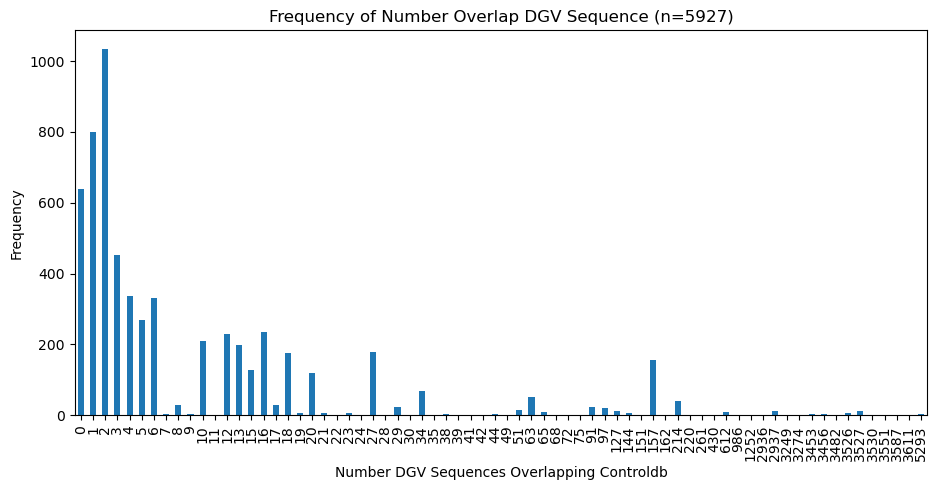

In [22]:
sv_df['num_overlap_DGV'].value_counts().sort_index().plot(kind='bar', figsize=(11, 5), title=f'Frequency of Number Overlap DGV Sequence (n={len(sv_df)})', xlabel='Number DGV Sequences Overlapping Controldb', ylabel='Frequency')

In [23]:
sv_overlap_HI_gene = sv_df
sv_bkpt_in_HI_gene = sv_df.loc[sv_df['num_bkpt_HI'] > 0]
sv_overlap_HI_exon = sv_df.loc[(sv_df['Overlap_HI_exons'] != '-')]
sv_bkpt_in_HI_exon = sv_df.loc[(sv_df['Overlap_HI_exons'] != '-') & (sv_df['num_bkpt_HI_exon'] > 0)]

In [24]:
# sv_df = sv_df.loc[(sv_df['Overlap_HI_exons'] != '-')]

How many breakpoints in each gene? Does it support the poster's conclusion that partial dups are similare across pop. and clinical dbs.

In [25]:
print(f"{len(sv_df[sv_df['HI_exon_bkpt'] != '-'])} ins/dup that have at least one breakpoint in a HI=3 gene")

69 ins/dup that have at least one breakpoint in a HI=3 gene


In [26]:
plot_df = sv_df[sv_df['HI_exon_bkpt'] != "-"].groupby(['Overlap_HI_genes']).agg({'num_bkpt_HI': sum}).reset_index()
plot_df = plot_df.sort_values(by='num_bkpt_HI', ascending=False)

out_file(plot_df, "num_breakpoints_insdup_HI_genes")

<Axes: title={'center': 'Number of breakpoints overlapping HI genes'}, xlabel='Overlap_HI_genes'>

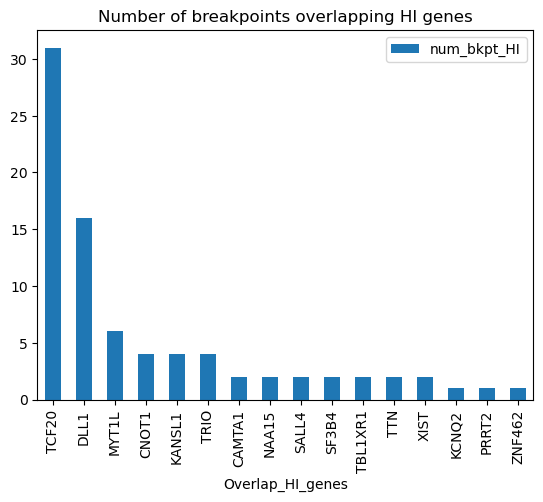

In [27]:
plot_df.plot.bar(x='Overlap_HI_genes', stacked=True, title='Number of breakpoints overlapping HI genes')

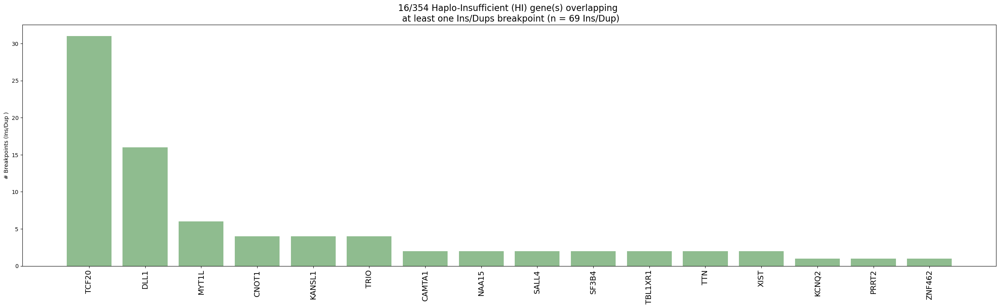

In [28]:
plt.figure(figsize=(32,8))
plt.bar(plot_df['Overlap_HI_genes'], plot_df['num_bkpt_HI'], color='darkseagreen')
plt.title(f"{len(plot_df['Overlap_HI_genes'].unique())}/354 Haplo-Insufficient (HI) gene(s) overlapping \n at least one Ins/Dups breakpoint (n = {len(sv_df[sv_df['HI_exon_bkpt'] != '-'])} Ins/Dup)", fontsize=16)
plt.xticks(rotation=90, fontsize=14)
plt.ylabel("# Breakpoints (Ins/Dup )")
plt.show()

which publication genes of interest in plot_df have breakpoints/SVs/Genes?


In [29]:
def get_unique_genes(gene_col):
    return ";".join(list(gene_col.unique())).split(";")

def get_num_genes(gene_col):
    return len(";".join(list(gene_col.unique())).split(";"))

# Helper function to get a list of single genes; splitting multiple genes by separator
def split_genes_into_list(gene_list, sep):
    genes = []

    # Find rows with separator, split them, and reappend in final list.
    for gene in gene_list:
        if sep in gene:
            # split by separator and append 
            genes.extend(gene.split(sep))
        else:
            genes.append(gene)
    
    genes = [g.strip() for g in genes]

    return genes

In [30]:
get_num_genes(cluster_df['Overlap_HI_genes'])

113

In [31]:
# Helper function to plot number of bkpts in diff subset of sv_df and highlight genes
def plot_HI_bkpt_freq(in_sv_df, subset, gene_exon):
    # Find num bkpts in input_df
    print(f"{len(in_sv_df)} ins/dup in subset")

    # summarize sv_df into a tabler eady to be plotted. Sort freq of bkpts by largest first
    plot_df = in_sv_df.groupby(['Overlap_HI_genes']).agg({'num_bkpt_HI': sum}).reset_index()
    plot_df = plot_df.sort_values(by='num_bkpt_HI', ascending=False)

    # save table as file
    # out_file(plot_df, "num_breakpoints_insdup_HI_genes")
    pub_HI_genes = ['ABCD1', 'TRIO', 'KMT2C', 'TRIP12', 'POGZ', 
                    'MAGT1', 'SHOX', 'STS', 'ZMYND11', 'GRIN2A', 
                    'MYT1L', 'CHEK2', 'NFIA', 'CHD2', 'AUTS2']
    
    colors = ['goldenrod' if gene in pub_HI_genes else 'darkseagreen' for gene in plot_df['Overlap_HI_genes']]

    plt.figure(figsize=(32,8))
    plt.bar(plot_df['Overlap_HI_genes'], plot_df['num_bkpt_HI'], color=colors)
    # plt.title(f"{len(sv_df)} Ins/Dups {subset} {get_num_genes(plot_df['Overlap_HI_genes'])} Haplo-Insufficient (HI) {gene_exon}", fontsize=16)
    plt.title(f"{len(in_sv_df)} Ins/Dups {subset} Haplo-Insufficient (HI) {gene_exon}", fontsize=16)
    plt.xticks(rotation=90, fontsize=14)
    # plt.yscale('log')
    plt.ylabel("# Ins/Dups", fontsize=14)
    plt.show()

5927 ins/dup in subset


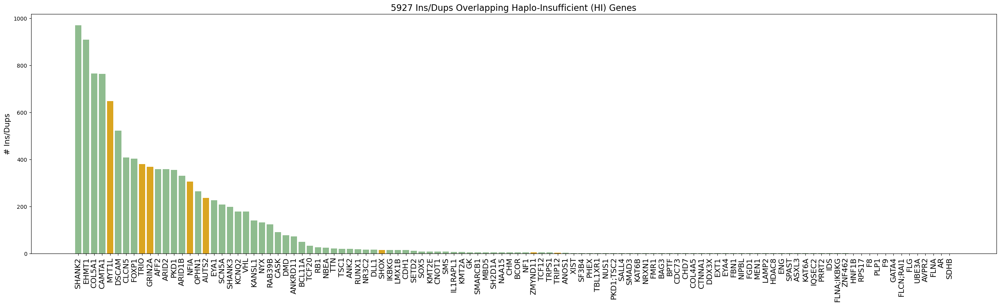

In [32]:
plot_HI_bkpt_freq(sv_df, "Overlapping","Genes")

In [33]:
# plot_HI_bkpt_freq(cluster_df, "")

In [34]:
list(set(get_unique_genes(sv_df['Overlap_HI_genes'])) - set(get_unique_genes(cluster_df['Overlap_HI_genes'])))

[]

In [35]:
print(list(get_unique_genes(sv_df['Overlap_HI_genes'])).sort())

None


How many of these Ins/Dup overlap exons? All of them

In [36]:
sv_df.head()

,Sample,Type,algorithm,chr,RefStartPos,RefEndPos,SVsize,Zygosity,Confidence,smapID,has_gaps,Overlap_HI_genes,cluster_ID,Overlap_HI_exons,HI_gene_bkpt,HI_exon_bkpt,num_bkpt_HI,num_bkpt_HI_exon,num_overlap_DGV
0,15_dle1_sop,ins,assembly_comparison,23,148578373.0,148582267.0,1030.0,heterozygous,0.99,16924,FALSE,AFF2,21861,-,Left;Right,-,2,0,1
1,21_dle1_sop,ins,assembly_comparison,23,148578373.0,148582267.0,700.0,heterozygous,0.82,17579,FALSE,AFF2,21861,-,Left;Right,-,2,0,1
2,68_dle1_sop,ins,assembly_comparison,23,148578373.0,148582267.0,1054.0,heterozygous,0.99,16083,FALSE,AFF2,21861,-,Left;Right,-,2,0,1
3,99_dle1_sop,ins,assembly_comparison,23,148578373.0,148582267.0,876.0,heterozygous,0.82,17032,FALSE,AFF2,21861,-,Left;Right,-,2,0,1
4,113_dle1_sop,ins,assembly_comparison,23,148578373.0,148582267.0,985.0,heterozygous,0.82,16286,FALSE,AFF2,21861,-,Left;Right,-,2,0,1


In [37]:
# sv_non_overlap = sv_df.loc[sv_df['overlap_exons'] == "-"]
# sv_df = sv_df.loc[sv_df['Overlap_HI_exons'] != "-"]

In [38]:
# plot_HI_bkpt_freq(sv_df, "Overlapping hg38 exons")

In [39]:
HI_gene_summary = cluster_df.groupby('Overlap_HI_genes').agg(
    {
        # 'Sample_ID': lambda x: x.nunique(),
        'num_SVs':"count",
        # 'num_unique_samples':sum
        'num_unique_samples':"count"
    }
)
HI_gene_summary = HI_gene_summary.reset_index()
HI_gene_summary.sort_values(by=['num_unique_samples'], ascending=False)

,Overlap_HI_genes,num_SVs,num_unique_samples
63,MYT1L,17,17
29,EHMT1,15,15
14,CAMTA1,13,13
23,COL5A1,13,13
28,DSCAM,11,11
...,...,...,...
47,HDAC8,1,1
45,GK,1,1
42,FMR1,1,1
41,FLNA;IKBKG,1,1


['duplication', 'duplication_inverted', 'duplication_split', 'ins']
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15, 16, 17, 18, 20, 21, 22, 23]


C:\Users\sshukor\AppData\Local\Temp\ipykernel_46672\4251617788.py:4: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use('seaborn-ticks')


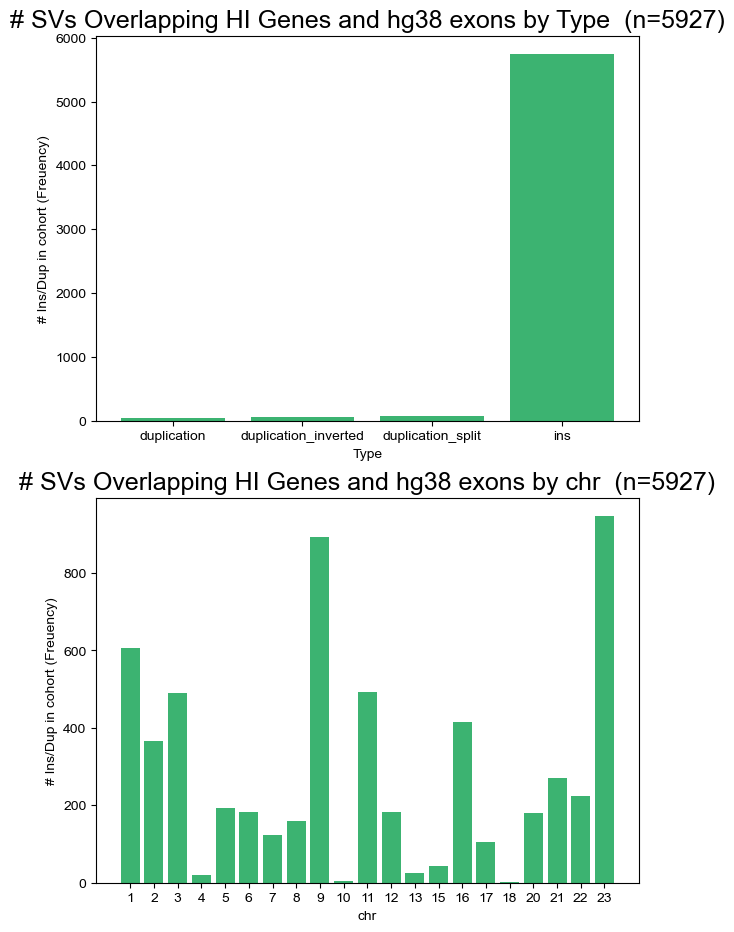

In [40]:
cols = ['Type', 'chr']

fig, axes = plt.subplots(nrows=len(cols), ncols=1, figsize=(7, 11))
plt.style.use('seaborn-ticks')

for c, ax in zip(cols, axes.ravel()):
    # set x-axis labels
    xlabel = sorted(pd.unique(sv_df[c]))
    print(xlabel)
    x = np.arange(len(xlabel))

    # standardize value counts by x axis to account for missing values in one df or the other
    dn = sv_df[c].value_counts().sort_index().to_frame()

    # plot counts side by side in a bar graph
    ax.bar(x, dn.iloc[:, 0],color='mediumseagreen', label='DN HI Overlaps')
    ax.set_title(f"# SVs Overlapping HI Genes and hg38 exons by {c}  (n={len(sv_df)})", fontsize=18, y=1)
    ax.set_xlabel(f'{c}')
    ax.set_ylabel(f"# Ins/Dup in cohort (Freuency)")
    ax.set_xticks(x, xlabel)

plt.show()  

C:\Users\sshukor\AppData\Local\Temp\ipykernel_46672\1400203106.py:33: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use('seaborn-ticks')


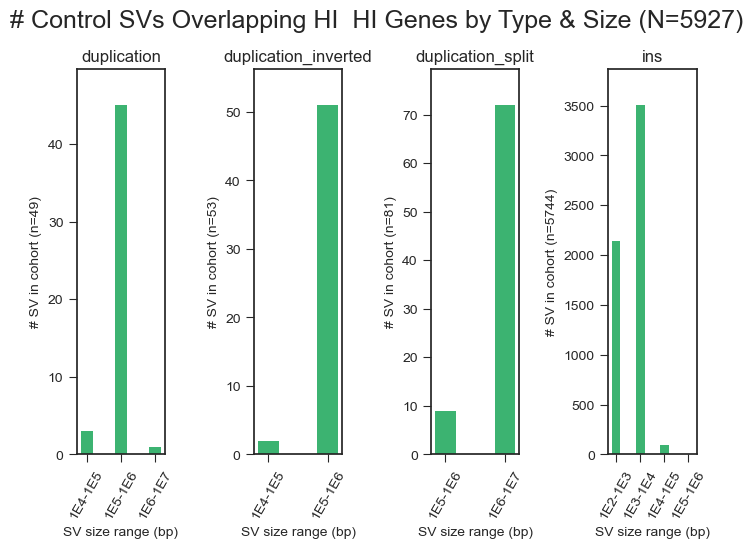

In [63]:
def tabulate_sv_by_type_size(input_df):
    input_df = input_df.astype({'SVsize':'float64'})
    
    # get power of every row in df
    input_df['SVsize'] = np.round(input_df['SVsize']).astype(int)
    input_df['exp_factor'] = input_df['SVsize'].apply(lambda x: len(str(x)))
    

    groups = dict(list(input_df.groupby(by=['Type', 'exp_factor'])))
    # print(len(groups))

    sv_table = pd.DataFrame()
    for df in groups.values():

        row = copy.deepcopy(df[['Type', 'exp_factor']].head(1))

        # row['exp_factor'] = '<10E' + row['exp_factor'].astype('str')
        row['exp_factor'] = f"1E{int(row['exp_factor']) - 1}-1E{int(row['exp_factor'])}"
        row['sv_counts'] = len(df)
        sv_table = pd.concat([sv_table, row], axis=0, ignore_index=True)


    sv_table = sv_table.rename(columns={'exp_factor':'SV size (bp)'})

    return sv_table


def plot_SV_by_type_size_norm_type(df, color, subset, gene_exon):
    # inDelDupInv = ['ins', 'del', 'duplication','duplication_inverted', 'duplication_split', 'inv']

    fig, axes = plt.subplots(nrows=1, ncols=len(pd.unique(df['Type'])), figsize=(8, 5))
    plt.subplots_adjust(wspace=1)
    plt.style.use('seaborn-ticks')
    # print(plt.style.available)
    fig.suptitle(f"# Control SVs {subset} HI  {gene_exon} by Type & Size (N={df['sv_counts'].sum()})", fontsize=18, y=1)

    out_df = pd.DataFrame()
    # plot SVs frequencies by site
    for type, ax in zip(pd.unique(df['Type']), axes.ravel()):
        ax, temp_df = plot_SV_frequency_by_size(ax, color, df.loc[df['Type'] == type], type)
        out_df = pd.concat([out_df, temp_df], axis=0, ignore_index=True)

    # plt.legend(bbox_to_anchor=[1, 0.2])
    plt.show()  

    out_file(out_df, f"ctrldb_HI_typeSizeBins_frequencies")


def plot_SV_frequency_by_size(ax, color, df, type):
    # set x-axis labels
    xlabel = df['SV size (bp)']
    x = np.arange(len(xlabel))
    width = 0.35

    # plot normalize overlap and non-overlaps
    ax.bar(x, df['sv_counts'], width, color=color, label='DN Controldb HI Overlaps')

    # set axis title and labels
    # ax.grid(False)
    ax.set_title(f"{type}")
    ax.set_xlabel('SV size range (bp)')
    ax.set_ylabel(f"# SV in cohort (n={df['sv_counts'].sum()})")
    ax.set_ylim(top=ax.get_ylim()[1] * 1.05)
    # ax.set_yscale('log')
    ax.set_xticks(x, xlabel, rotation=60)

    return ax, df

DN_sv_sizes = tabulate_sv_by_type_size(sv_df)
# plot_SV_by_type_size_norm_type(DN_sizes, 'cornflowerblue', "HI")
plot_SV_by_type_size_norm_type(DN_sv_sizes, 'mediumseagreen', "Overlapping", 'HI Genes')

Find # unique dle1 samples per shared SV

In [42]:
# Helper function to get a list of single genes; splitting multiple genes by separator
def split_genes_into_list(gene_list, sep):
    genes = []

    # Find rows with separator, split them, and reappend in final list.
    for gene in gene_list:
        if sep in gene:
            # split by separator and append 
            genes.extend(gene.split(sep))
        else:
            genes.append(gene)
    
    genes = [g.strip() for g in genes]

    return genes

# # Function test
# list1 = ["A", "A;B", "B", "C", "A;B;C"]
# split_genes_into_list(list1, sep=";")

# Helper function to tabulate gene frequency, given a list of genes
def tabulate_gene_freq(gene_list, n_cutoff):

    # find rows multiple genes and split them into individual genes
    if ";" in ''.join(gene_list):
        gene_list = split_genes_into_list(gene_list, ";")
    else:
        print("No SVs overlapping multiple genes")
    
    # print(f"Total genes: {len(gene_list)}")
    print(f"Unique genes: {len(set(gene_list))}")

    # group genes and count frequencies of genes in sample genelist
    # gene_freqs = [(key, len(list(group))) for key, group in groupby(gene_list)]
    frequency = {}

    # iterating over the list
    for item in gene_list:
    # checking the element in dictionary
        if item in frequency:
            # incrementing the count
            frequency[item] += 1
        else:
            # initializing the count
            frequency[item] = 1

    gene_freqs = pd.DataFrame.from_dict(frequency, orient='index', columns=['freq'])        
    gene_freqs.index.names = ['gene']
    gene_freqs.reset_index(inplace=True)

    # gene_freqs = pd.DataFrame(gene_freqs, columns=['gene', 'frequency'])
    gene_freqs.sort_values(by='freq', ascending=False, inplace=True)
    
    return gene_freqs[gene_freqs['freq'] > n_cutoff]

In [43]:
# len(cluster_df['Overlap_HI_genes'].unique())

In [44]:
# tabulate_gene_freq(cluster_df['Overlap_HI_genes'], 1)

,Gene,Overlap_HI_genes
0,SHANK2,485
1,EHMT1,480
2,COL5A1,383
3,CAMTA1,382
4,MYT1L,324
...,...,...
105,LAMP2,1
106,NIPBL,1
107,NRXN1,1
108,NUS1,1


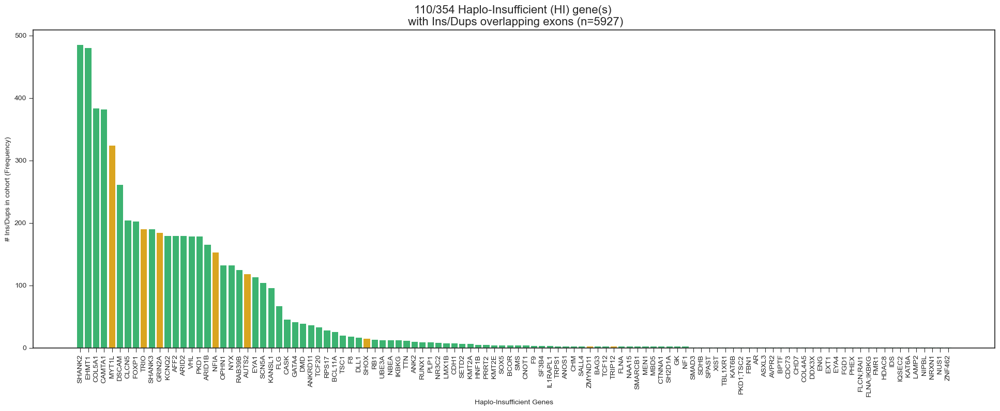

In [45]:
# plot repEx gene and frequency
gene_freq = pd.DataFrame(sv_df['Overlap_HI_genes'].value_counts().reset_index())
gene_freq = gene_freq.rename(columns={'index':'Gene'})

display(gene_freq)

# out_file(plot_df, "num_breakpoints_insdup_HI_genes")
pub_HI_genes = ['ABCD1', 'TRIO', 'KMT2C', 'TRIP12', 'POGZ', 
                'MAGT1', 'SHOX', 'STS', 'ZMYND11', 'GRIN2A', 
                'MYT1L', 'CHEK2', 'NFIA', 'CHD2', 'AUTS2']

colors = ['goldenrod' if gene in pub_HI_genes else 'mediumseagreen' for gene in gene_freq['Gene']]

plt.figure(figsize=(24,8))
plt.title(f"{len(gene_freq['Gene'])}/354 Haplo-Insufficient (HI) gene(s) \n with Ins/Dups overlapping exons (n={len(sv_df)})", fontsize=16)
plt.bar(gene_freq['Gene'], gene_freq['Overlap_HI_genes'], color=colors)
plt.xlabel("Haplo-Insufficient Genes")
plt.xticks(ticks=gene_freq['Gene'], rotation=90)
plt.ylabel("# Ins/Dups in cohort (Frequency)")

# gene_freq.plot.bar()
plt.show()


merge cluster and sv freq into 1 master table. Save it as a master table


In [46]:
# helper function to plot SV clusters 
def plot_SV_clusters(df):

    def get_sv_type(type_str):
        # type_str = type_str.strip()
        if "ins" in type_str:
            return "Insertion"
        elif "del" in type_str:
            return "Deletion"
        elif "dup" in type_str:
            return(type_str.capitalize())
        elif "inv" in type_str:
            return "Inversion"
        elif "trans" in type_str:
            return "Translocation"
        else:
            return(type_str.capitalize())
        # ignore duplications to stay in concordance with ctrl_df['Type]

    for index, row in df.iterrows():
        # process df for sample_ID, refStartPos, and refend lists
        genes = str(row['Overlap_HI_genes'])
        type = get_sv_type(str(row['Type']))
        zygo = str(row['Zygosity'])
        chr = str(row['chr'])
        cluster_id = str(row['cluster_ID'])

        sample_ids = re.split(',', str(row['Sample_ID']))
        starts = re.split(',', str(row['listRefStartPos']))
        ends = re.split(',', str(row['listRefEndPos']))
        sizes = re.split(',', str(row['SVsize']))

        # display(sample_ids , starts,ends ,sizes)
        # get widths between refstartpos and refendpos
        plot_df = pd.DataFrame(zip(sample_ids, starts, ends, sizes), columns=['Sample_ID', 'RefStartPos', 'RefEndPos', 'SVsize']).sort_values(by='Sample_ID', ascending=False)

        # add SV cluster ID
        # display(plot_df)
        for col in ['RefStartPos', 'RefEndPos', 'SVsize']:
            plot_df[col] = pd.to_numeric(plot_df[col], downcast="float")
        plot_df['width'] = plot_df['RefEndPos'] - plot_df['RefStartPos']
        

        # scale to map as subplot
        plt.figure(figsize=(5,0.5*len(plot_df)))
        plt.title(f'Cluster ID: {cluster_id} \n Chr {chr} {type} overlapping {genes} \n (Zygosity: {zygo})')
        plt.barh(plot_df['Sample_ID'], width=plot_df['width'], height=0.3, left=plot_df['RefStartPos'], color='0.95', label= 'Ref Range')
        plt.barh(plot_df['Sample_ID'], width=plot_df['SVsize'], height=0.3, left=plot_df['RefStartPos'], color='silver', label='SV size')
        plt.scatter(plot_df['RefStartPos'], plot_df['Sample_ID'], c='black',marker='|', s=100, label='Ref Start')
        plt.scatter(plot_df['RefEndPos'], plot_df['Sample_ID'], c='gray', marker='|',alpha=0.8, s=100, label='Ref End')

        # format x axis
        padding = 0.05*(plot_df['RefEndPos'].max() - plot_df['RefStartPos'].min())
        lower_x = int(plot_df['RefStartPos'].min()-padding)
        upper_x = int(plot_df['RefEndPos'].max()+ padding)
        ticks = np.arange(lower_x, upper_x, int((upper_x-lower_x)/10))
        tick_bins = int((upper_x-lower_x)/10)
        plt.xticks(ticks=ticks, labels=ticks, rotation=50)
        plt.xlabel(rf'Reference Coordinates (intervals= {tick_bins} bps)')
        plt.xlim(lower_x, upper_x)
        plt.legend(loc='upper right', bbox_to_anchor=(1.4, .95))
        plt.show()

# cluster_df.loc[cluster_df["Type"].str.contains("dup")].sort_values(by='num_unique_samples', ascending=False).head(10)

Number of unique DLE1 samples with ins/dup overlapping genes

-   Plot of sv types with genes on x axis, and num of dle1 enzymes shared in y
-   

In [47]:
sv_df.groupby(['Type','Overlap_HI_genes']).agg({'Sample':lambda x: len(set(";".join(x).split(";")))}).reset_index().sort_values('Sample', ascending=False)


,Type,Overlap_HI_genes,Sample
34,ins,CAMTA1,179
63,ins,GRIN2A,179
61,ins,FOXP1,179
101,ins,SHANK2,179
27,ins,ARID2,179
...,...,...,...
70,ins,KAT6B,1
74,ins,LAMP2,1
83,ins,NIPBL,1
85,ins,NRXN1,1


In [48]:
# for sv_type in list(cluster_df['Type'].unique()):
#     # plot HI gene and frequency
#     gene_freq = pd.DataFrame(cluster_df.loc[cluster_df['Type'] == sv_type].groupby(['Type', 'Overlap_HI_genes']).agg({'Sample':lambda x: len(set(", ".join(x).split(", ")))}).reset_index().sort_values('Sample', ascending=False))
#     gene_freq = gene_freq.rename(columns={'Overlap_HI_genes':'Gene'})

#     display(gene_freq)

#     plt.figure(figsize=(24,8))
#     # plt.title(f"Top 75 Haplo-Insufficient (HI) genes \n with the most DLE1 samples (n={len(sv_df)} {sv_type}s)", fontsize=26)
#     plt.title(f"Number DLE1 samples with {' '.join(sv_type.split('_')).capitalize()} \n overlapping Haplo-Insufficient (HI) genes (N=179 DLE1 samples in controldb)", fontsize=24)
#     plt.bar(gene_freq['Gene'], gene_freq['Sample'], color='pink')
#     plt.xlabel("Haplo-Insufficient Genes")
#     plt.xticks(ticks=gene_freq['Gene'], rotation=90)
#     plt.ylabel("Frequency Unique DLE1 samples")

#     # gene_freq.plot.bar()
#     plt.show()

In [49]:
# # plot HI gene and frequency
# gene_freq = pd.DataFrame(cluster_df[cluster_df['Type'].str.contains("duplicaion")].groupby(['Overlap_HI_genes']).agg({'Sample_ID':lambda x: len(set(", ".join(x).split(", ")))}).reset_index().sort_values('Sample_ID', ascending=False))
# gene_freq = gene_freq.rename(columns={'Overlap_HI_genes':'Gene'})

# # display(gene_freq)

# plt.figure(figsize=(24,8))
# plt.title(f"Top 75 Haplo-Insufficient (HI) genes \n with the most DLE1 samples (n={len(sv_df)})", fontsize=16)
# plt.bar(gene_freq['Gene'], gene_freq['Sample_ID'], color='pink')
# plt.xlabel("Haplo-Insufficient Genes")
# plt.xticks(ticks=gene_freq['Gene'], rotation=90)
# plt.ylabel("# Ins/Dups (Frequency)")

# # gene_freq.plot.bar()
# plt.show()

110

113

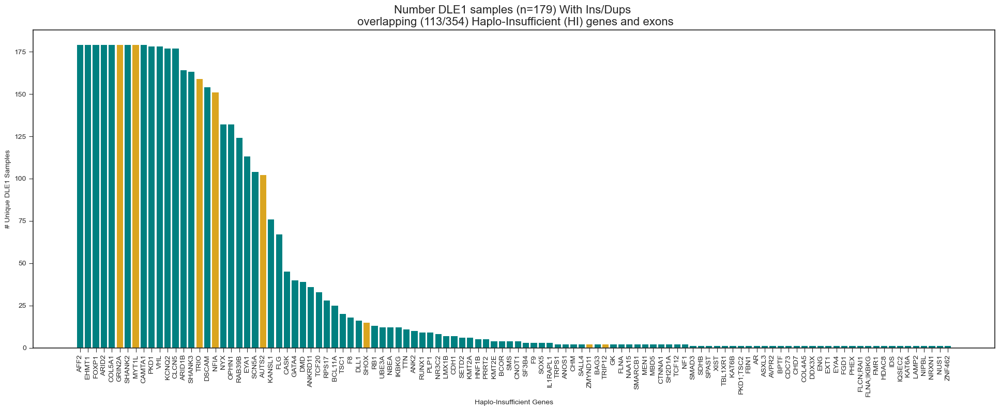

In [50]:
# plot HI gene and frequency
gene_freq = pd.DataFrame(sv_df.groupby(['Overlap_HI_genes']).agg({'Sample':lambda x: len(set(",".join(x).split(",")))}).reset_index().sort_values('Sample', ascending=False))
gene_freq = gene_freq.rename(columns={'Overlap_HI_genes':'Gene'})

display(len(gene_freq['Gene'].unique()))
display(get_num_genes(gene_freq['Gene']))

# out_file(plot_df, "num_breakpoints_insdup_HI_genes")
pub_HI_genes = ['ABCD1', 'TRIO', 'KMT2C', 'TRIP12', 'POGZ', 
                'MAGT1', 'SHOX', 'STS', 'ZMYND11', 'GRIN2A', 
                'MYT1L', 'CHEK2', 'NFIA', 'CHD2', 'AUTS2']

colors = ['goldenrod' if gene in pub_HI_genes else 'teal' for gene in gene_freq['Gene']]

plt.figure(figsize=(24,8))
plt.title(f"Number DLE1 samples (n=179) With Ins/Dups \n overlapping ({get_num_genes(gene_freq['Gene'])}/354) Haplo-Insufficient (HI) genes and exons", fontsize=16)
plt.bar(gene_freq['Gene'], gene_freq['Sample'], color=colors)
plt.xlabel("Haplo-Insufficient Genes")
plt.xticks(ticks=gene_freq['Gene'], rotation=90)
plt.ylabel("# Unique DLE1 Samples")

# gene_freq.plot.bar()
plt.show()

In [51]:
def plot_dle1_freq(in_sv_df, subset, gene_exon):
    # plot HI gene and frequency
    gene_freq = pd.DataFrame(in_sv_df.groupby(['Overlap_HI_genes']).agg({'Sample':lambda x: len(set(",".join(x).split(",")))}).reset_index().sort_values('Sample', ascending=False))
    gene_freq = gene_freq.rename(columns={'Overlap_HI_genes':'Gene'})

    # display(gene_freq)

    # out_file(plot_df, "num_breakpoints_insdup_HI_genes")
    pub_HI_genes = ['ABCD1', 'TRIO', 'KMT2C', 'TRIP12', 'POGZ', 
                    'MAGT1', 'SHOX', 'STS', 'ZMYND11', 'GRIN2A', 
                    'MYT1L', 'CHEK2', 'NFIA', 'CHD2', 'AUTS2']

    colors = ['goldenrod' if gene in pub_HI_genes else 'teal' for gene in gene_freq['Gene']]

    plt.figure(figsize=(24,8))
    plt.title(f"Number Control Samples (n=179) With Ins/Dups {subset} Haplo-Insufficient (HI) {gene_exon}", fontsize=16)
    plt.bar(gene_freq['Gene'], gene_freq['Sample'], color=colors)
    plt.xlabel("Haplo-Insufficient Genes")
    plt.xticks(ticks=gene_freq['Gene'], rotation=90)
    plt.ylabel("# Unique DLE1 Samples")

    # gene_freq.plot.bar()
    plt.show()
    

In [52]:
gene_freq['Gene'].str.contains('FOXP')

0      False
29     False
43      True
6      False
23     False
       ...  
59     False
68     False
70     False
71     False
109    False
Name: Gene, Length: 110, dtype: bool

In [53]:
sv_overlap_HI_gene = sv_df
sv_bkpt_in_HI_gene = sv_df.loc[sv_df['num_bkpt_HI'] > 0]
sv_overlap_HI_exon = sv_df.loc[(sv_df['Overlap_HI_exons'] != '-')]
sv_bkpt_in_HI_exon = sv_df.loc[(sv_df['Overlap_HI_exons'] != '-') & (sv_df['num_bkpt_HI_exon'] > 0)]

In [64]:
def plot_sv_df(in_sv_df, subset, gene_exon):
    # plot # unique ins/dup per HI gene
    # plot_HI_bkpt_freq(in_sv_df, "Overlapping hg38 exons")
    plot_HI_bkpt_freq(in_sv_df, subset, gene_exon)

    # plot # distribution of SV type and size
    DN_sv_sizes = tabulate_sv_by_type_size(in_sv_df)
    plot_SV_by_type_size_norm_type(DN_sv_sizes, 'mediumseagreen', subset, gene_exon)


    # plot # DLE1 with ins/dup 
    plot_dle1_freq(in_sv_df, subset, gene_exon)


    # plot DGV overlaps
    in_sv_df['num_overlap_DGV'].value_counts().sort_index().plot(kind='bar', figsize=(11, 5), title=f'{len(in_sv_df)} Controldb Ins/Dups Overlapping DGV Entries', xlabel='Number Overlapping DGV Entries', ylabel='Number Ins/Dups')

In [65]:
# How many SVs overlap HI genes total
n_sv_HI_gene = len(sv_df)
#   How many of these SVs have breakpoints in HI genes
n_bkpt_HI_gene = len(sv_df.loc[sv_df['num_bkpt_HI'] > 0])
# How many SVs overlap HI exon total
n_sv_HI_exon = len(sv_df.loc[(sv_df['Overlap_HI_exons'] != '-')])
#   How many of these SVs have breakpoints in HI genes
n_bkpt_HI_exon = len(sv_df.loc[(sv_df['Overlap_HI_exons'] != '-') & (sv_df['num_bkpt_HI_exon'] > 0)])

print(n_sv_HI_gene, n_bkpt_HI_gene, n_sv_HI_exon, n_bkpt_HI_exon)

5927 5731 2862 69


5927 ins/dup in subset


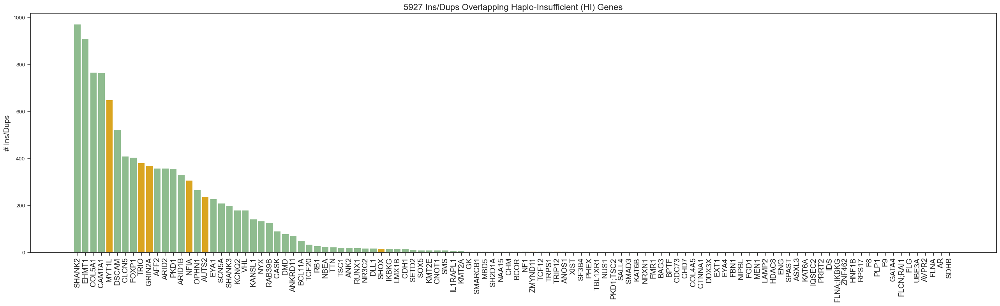

C:\Users\sshukor\AppData\Local\Temp\ipykernel_46672\1400203106.py:33: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use('seaborn-ticks')


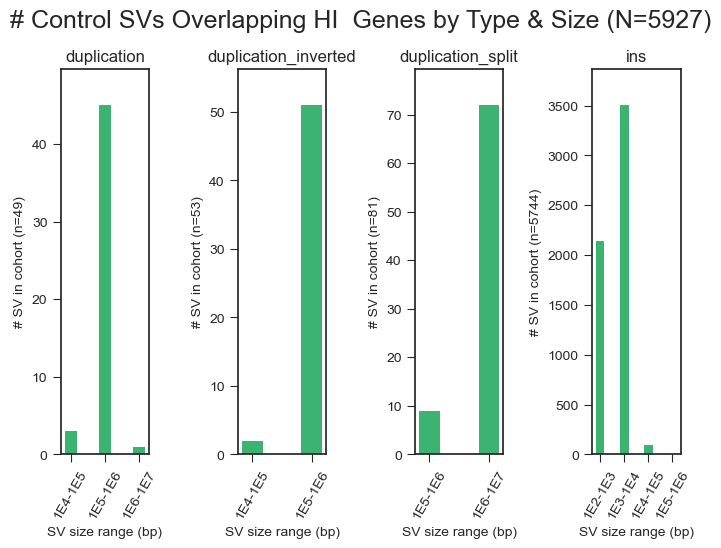

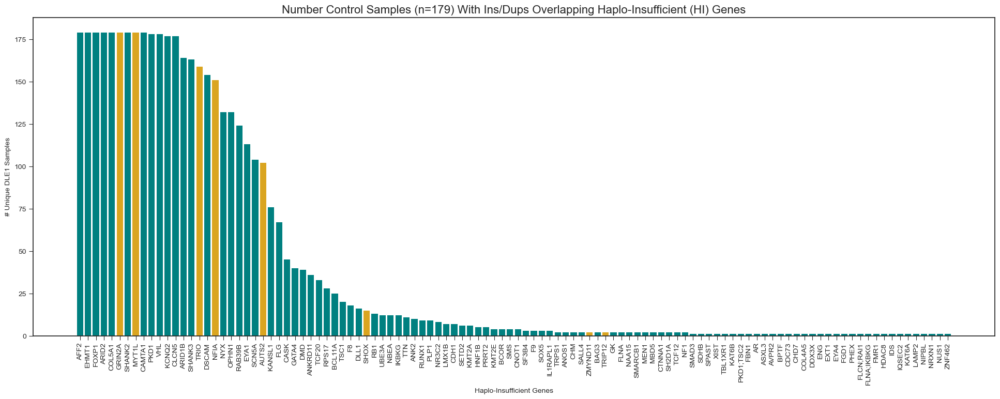

5731 ins/dup in subset


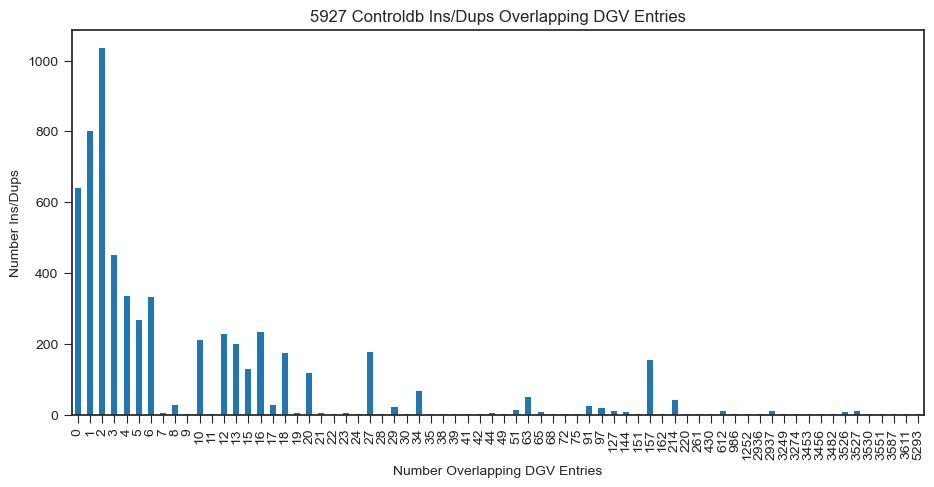

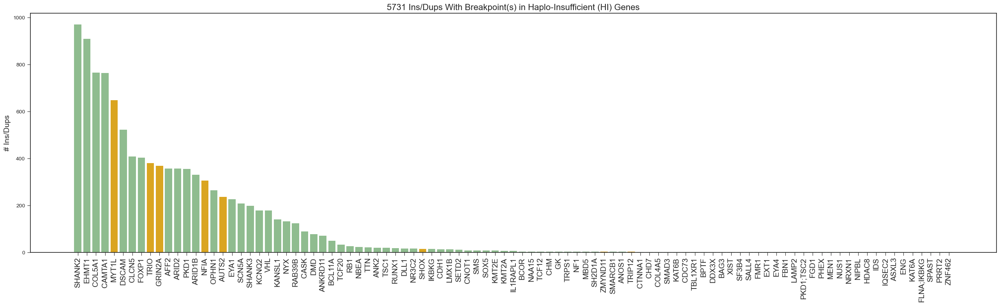

C:\Users\sshukor\AppData\Local\Temp\ipykernel_46672\1400203106.py:33: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use('seaborn-ticks')


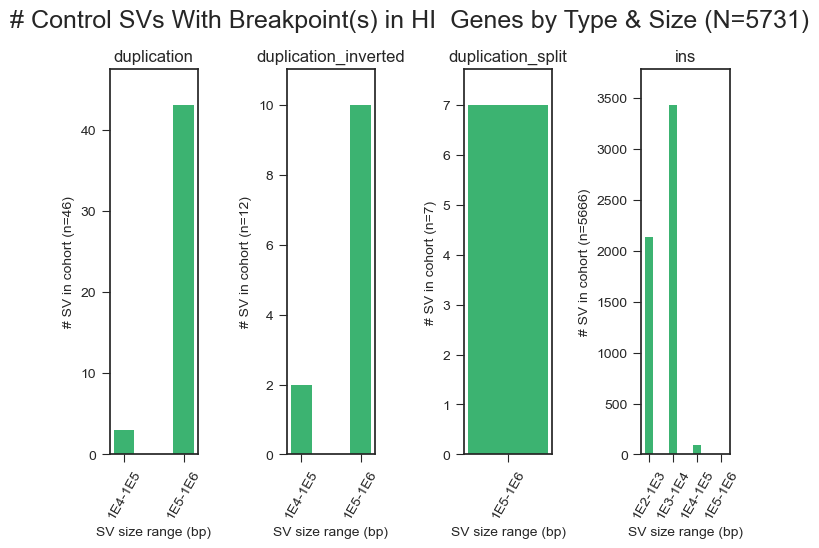

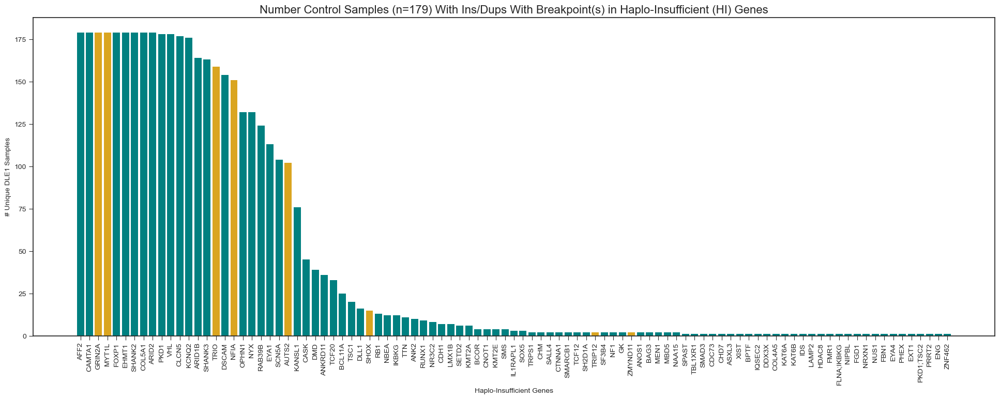

2862 ins/dup in subset


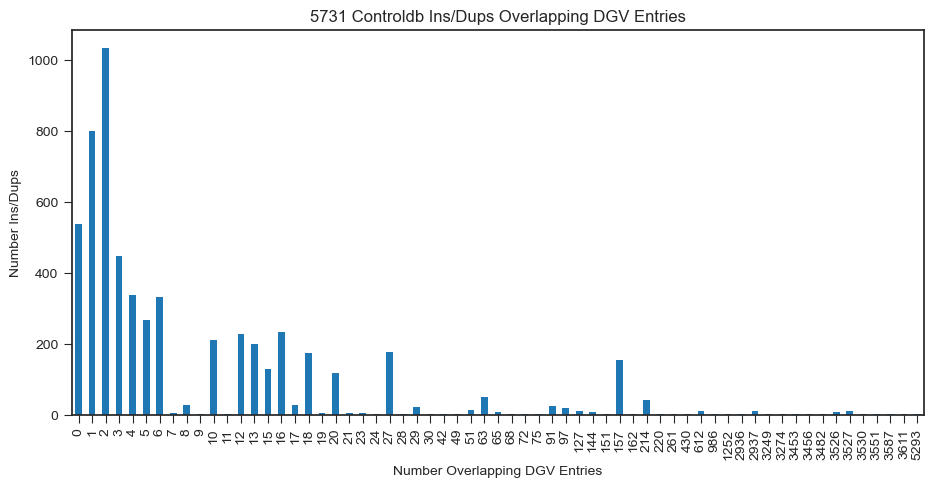

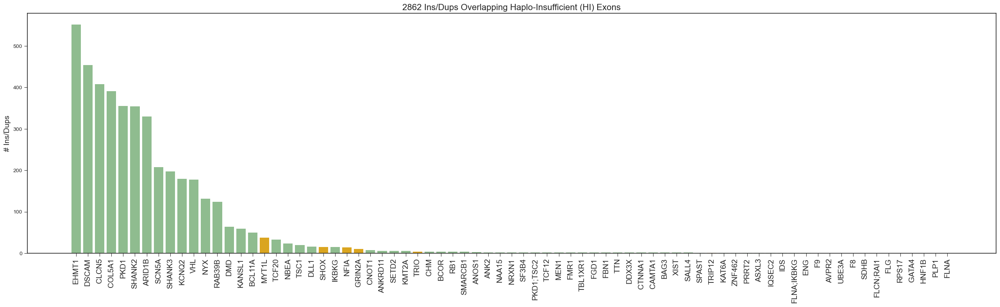

C:\Users\sshukor\AppData\Local\Temp\ipykernel_46672\1400203106.py:33: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use('seaborn-ticks')


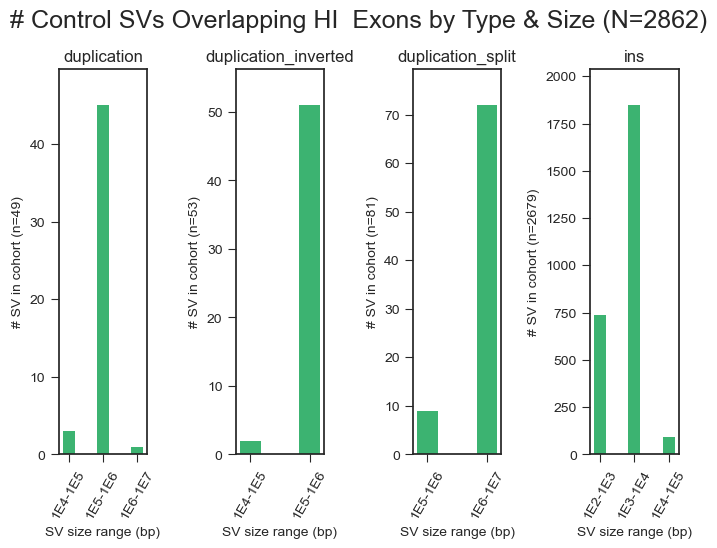

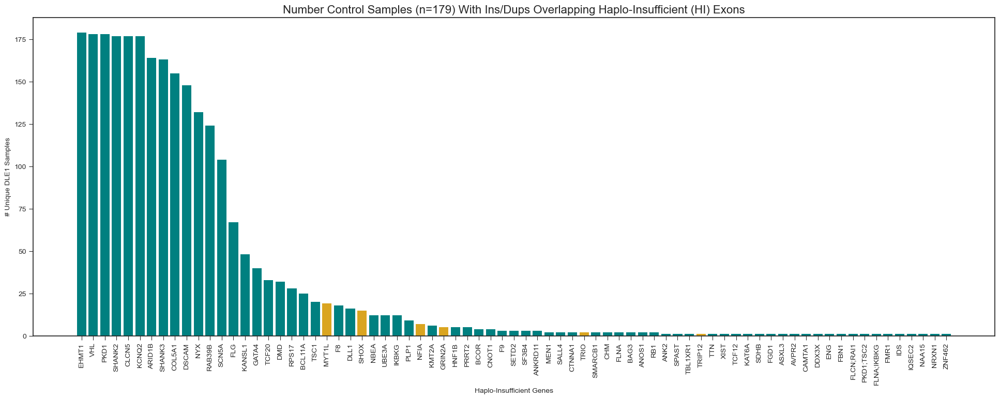

69 ins/dup in subset


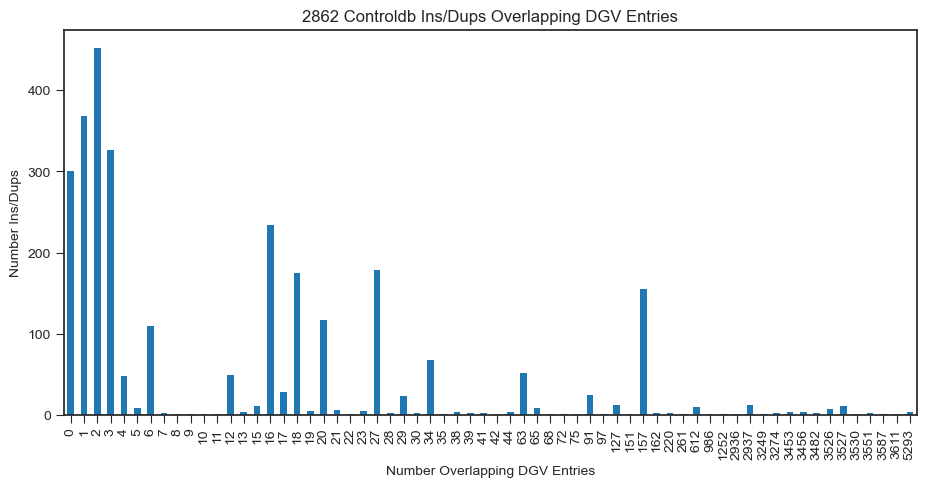

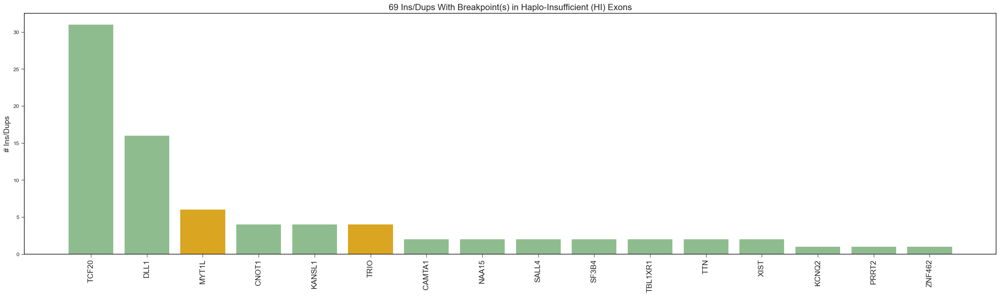

C:\Users\sshukor\AppData\Local\Temp\ipykernel_46672\1400203106.py:33: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use('seaborn-ticks')


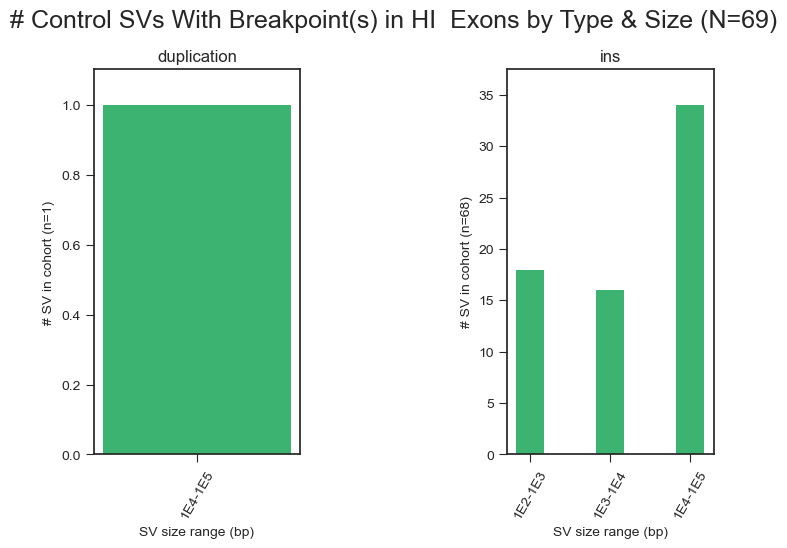

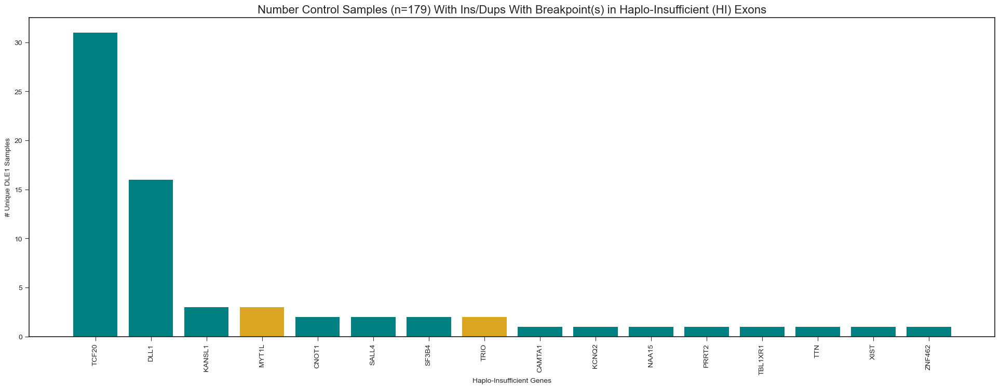

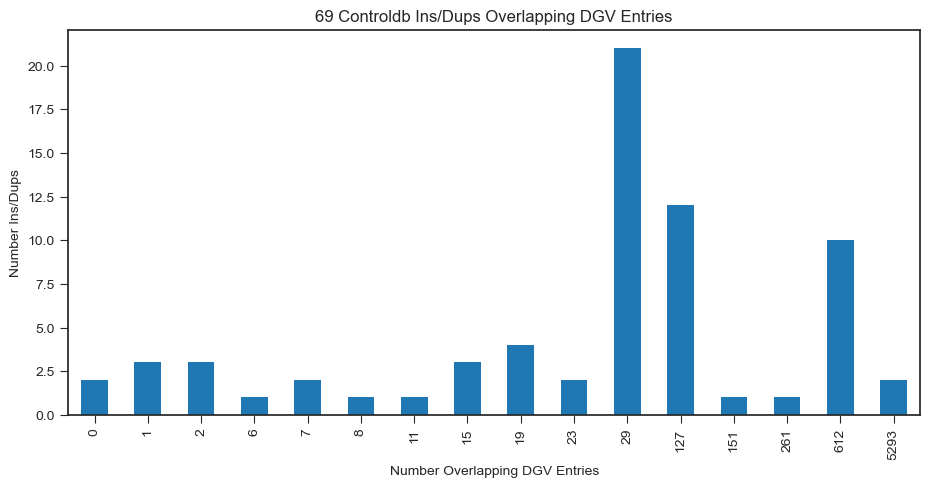

In [66]:
plot_sv_df(sv_overlap_HI_gene, "Overlapping", "Genes")
plot_sv_df(sv_bkpt_in_HI_gene, "With Breakpoint(s) in", "Genes")
plot_sv_df(sv_overlap_HI_exon, "Overlapping", "Exons")
plot_sv_df(sv_bkpt_in_HI_exon, "With Breakpoint(s) in", "Exons")